In [1]:
%load_ext lab_black
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import glob
from pathlib import Path
import requests
import itertools
import re
import sys
from matplotlib.ticker import PercentFormatter
import scanpy as sc
import anndata as ad
import cello
from statannot import add_stat_annotation
from statannotations.Annotator import Annotator
import harmonypy as hm
from scipy import stats
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from multiprocessing import cpu_count
from matplotlib.pyplot import rc_context
from matplotlib.colors import ListedColormap, LinearSegmentedColormap

%matplotlib inline
show_plot = True

/Users/senosam/opt/anaconda3/lib/python3.7/site-packages/numba/core/errors.py:149: UserWarning: Insufficiently recent colorama version found. Numba requires colorama >= 0.3.9
  warnings.warn(msg)


In [2]:
def move_legend(ax, new_loc, **kws):
    old_legend = ax.legend_
    handles = old_legend.legendHandles
    labels = [t.get_text() for t in old_legend.get_texts()]
    title = old_legend.get_title().get_text()
    ax.legend(handles, labels, loc=new_loc, title=None, **kws)

In [3]:
sc.settings.set_figure_params(dpi=80, facecolor="white")

In [4]:
path_raw = "../../data/TMA36_project/sc_RNAseq/processed/count cell ranger"
ls = os.listdir(path_raw)
path_ls = []
for i in ls:
    path_ls.append(Path("/".join([path_raw, i, "filtered_feature_bc_matrix.h5"])))
results_file = "../../data/TMA36_project/sc_RNAseq/processed/analyzed/all_samples.h5ad"  # the file that will store the analysis results

In [5]:
adata = sc.read(results_file)
adata.obs["cluster"] = adata.obs["cluster"].astype(str)

In [6]:
# series with sample names (pt_IDs)
sc_samp = adata.obs["sample"].unique()
sc_samp = pd.Series(sc_samp).astype(str)
# read clinical data and filter samples
cde = pd.read_csv("../../data/TMA36_project/CDE/CDE_TMA36_2021SEPT21_DR_MF_forMxIF.csv")
cde["cluster"] = cde["cluster"].fillna(0).astype(int)
cde["pt_ID"] = cde["pt_ID"].astype("str")
cde.set_index("pt_ID", inplace=True)
cde = cde.loc[sc_samp]

In [7]:
umap_cm = LinearSegmentedColormap.from_list(
    "custom red",
    [(0, "#d6d6d6"), (0.4, "#a8a8a8"), (0.8, "#c90000"), (1, "#ff0000")],
    N=256,
)

In [8]:
# data = np.random.random([100, 100]) * 10
# plt.figure(figsize=(7, 6))
# plt.pcolormesh(data, cmap=umap_cm)
# plt.colorbar()

In [9]:
cde.groupby("Group").size()

Group
Aggressive      7
Indolent        6
Intermediate    2
dtype: int64

In [10]:
cde.groupby("cluster").size()

cluster
0    7
1    1
2    3
4    4
dtype: int64

... storing 'cluster' as categorical


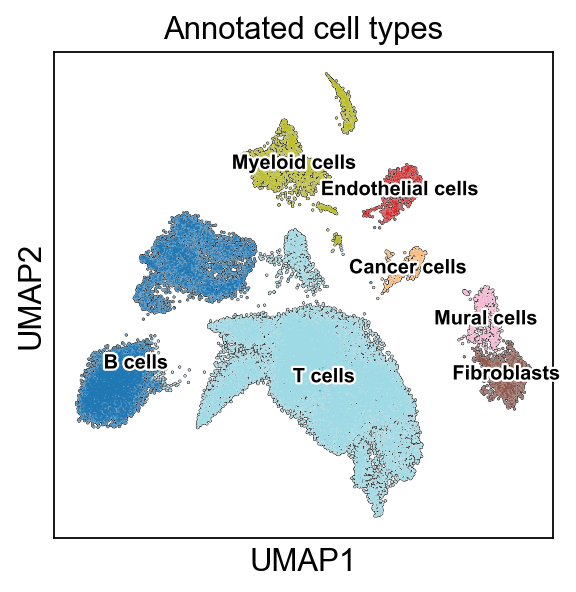

In [11]:
sc.pl.umap(
    adata,
    color=["annotated_ct_higher"],
    title=["Annotated cell types"],
    edges_color="black",
    legend_loc="on data",
    legend_fontsize=9,
    legend_fontoutline=2,
    palette="tab20",
    add_outline=True,
)

In [12]:
sc.tl.embedding_density(adata, basis="umap", groupby="Group")

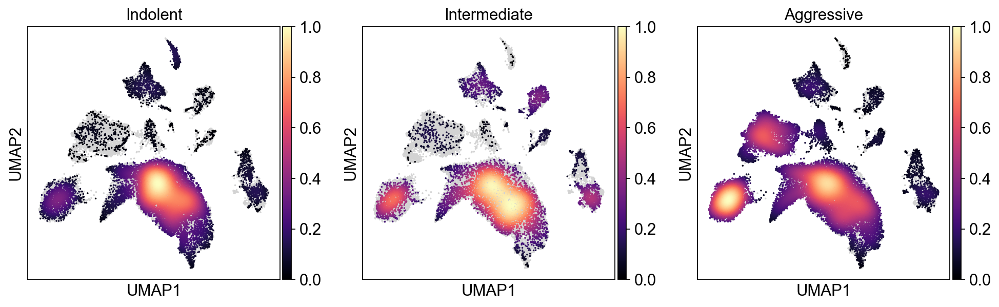

In [13]:
sc.pl.embedding_density(
    adata,
    basis="umap",
    groupby="Group",
    bg_dotsize=10,
    fg_dotsize=10,
    color_map="magma",
)

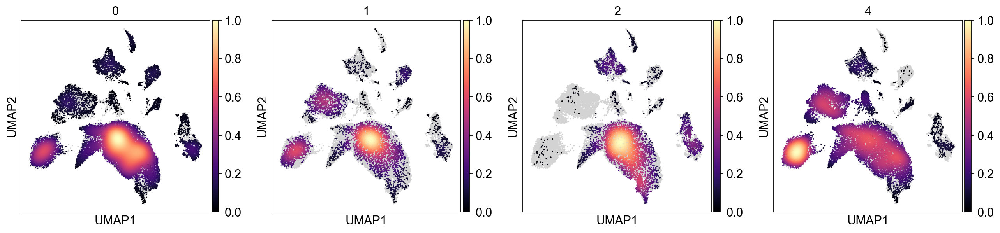

In [14]:
sc.tl.embedding_density(adata, basis="umap", groupby="cluster")
sc.pl.embedding_density(
    adata,
    basis="umap",
    groupby="cluster",
    bg_dotsize=10,
    fg_dotsize=10,
    color_map="magma",
)

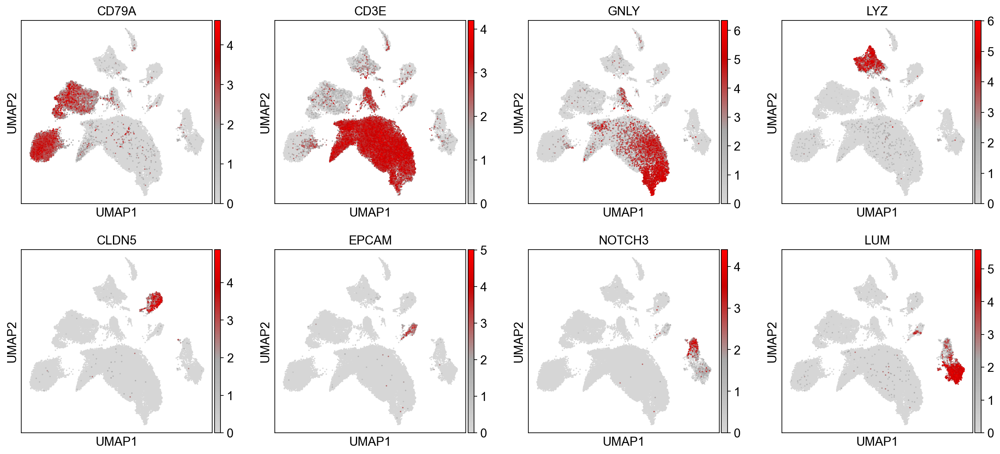

In [15]:
sc.pl.umap(
    adata,
    color=[
        "CD79A",
        "CD3E",
        "GNLY",
        "LYZ",
        "CLDN5",
        "EPCAM",
        "NOTCH3",
        "LUM",
    ],
    color_map=umap_cm,
    size=10,
)

# General comparisons

In [16]:
# Obtain df with proportions for cell types
count_mat_CT = pd.crosstab(adata.obs["sample"], adata.obs["annotated_ct_higher"])
perc_mat_CT = count_mat_CT.div(count_mat_CT.sum(axis=1), axis=0)
perc_mat_CT.index = perc_mat_CT.index.astype(str)
perc_mat_CT = cde[["Group", "cluster", "SILA_score"]].join(perc_mat_CT)
perc_mat_CT.reset_index(level=0, inplace=True, col_fill="pt_ID")
perc_mat_CT_long = pd.melt(
    perc_mat_CT,
    id_vars=["pt_ID", "Group", "cluster", "SILA_score"],
    var_name="cell_type",
    value_name="proportion",
)

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Indolent vs. Aggressive: Mann-Whitney-Wilcoxon test two-sided, P_val:3.832e-02 U_stat=6.000e+00
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Indolent vs. Aggressive: Mann-Whitney-Wilcoxon test two-sided, P_val:1.004e-01 U_stat=9.000e+00
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Indolent vs. Aggressive: Mann-Whitney-Wilcoxon test two-sided, P_val:9.430e-01 U_stat=2.000e+01
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <

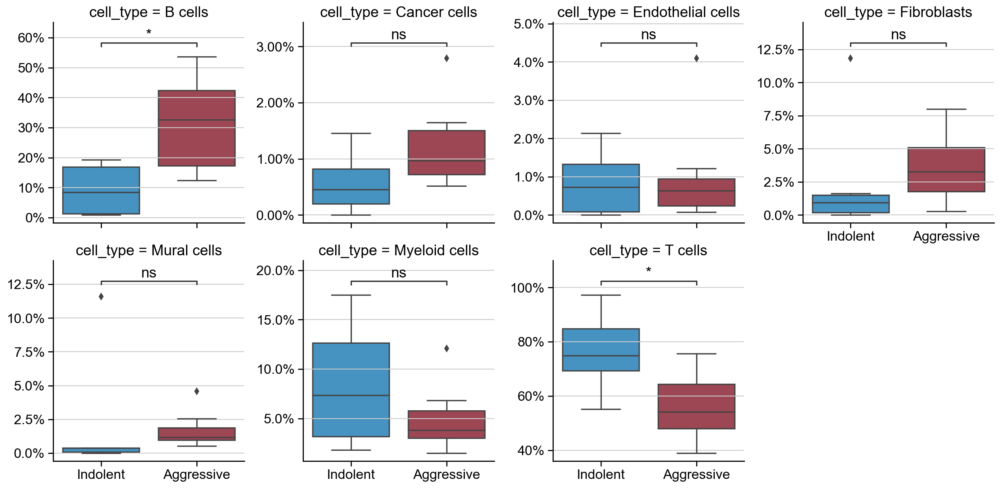

In [17]:
plotting_parameters = {
    "x": "Group",
    "y": "proportion",
    "order": ["Indolent", "Aggressive"],
    "palette": ["#3197d6", "#ab384a"],
}

pairs = [("Indolent", "Aggressive")]

with sns.plotting_context("notebook", font_scale=1.4):
    annot = Annotator(None, pairs)

    g = sns.FacetGrid(
        perc_mat_CT_long, col="cell_type", col_wrap=4, sharey=False, height=4
    )

    g.map_dataframe(
        annot.plot_and_annotate_facets,
        plot="boxplot",
        plot_params=plotting_parameters,
        configuration={"test": "Mann-Whitney"},
        annotation_func="apply_test",
    )
    for ax in g.axes.flat:
        ax.yaxis.set_major_formatter(PercentFormatter(1))

    plt.show()

# Reclustering

In [18]:
# function to get the cell fraction by a column
# outputs table in long format and plot
def cell_fraction(
    adata_ct,
    by_sample,
    cde,
    group_obsname,
    cluster_obsname,
    plot_hue,
    plot_palette,
    hue_order,
):
    adata_ct.obs["cluster"] = adata_ct.obs["cluster"].astype(int)

    df_leiden = pd.crosstab(adata_ct.obs[group_obsname], adata_ct.obs[cluster_obsname])
    if group_obsname == "cluster":
        df_leiden.drop([0], axis=0, inplace=True)

    df_leiden_fraq = df_leiden.div(df_leiden.sum(axis=0), axis=1)
    if by_sample == True:
        df_leiden_fraq.index = df_leiden_fraq.index.astype(str)
        df_leiden_fraq = cde[["Group", "cluster"]].join(df_leiden_fraq)
        df_leiden_fraq.reset_index(level=0, inplace=True, col_fill="pt_ID")
        df_leiden_fraq.fillna(0, inplace=True)
        df_leiden_fraq = pd.melt(
            df_leiden_fraq,
            id_vars=["pt_ID", "Group", "cluster"],
            var_name=cluster_obsname,
            value_name="fraction",
        )
    else:
        df_leiden_fraq = pd.melt(
            df_leiden_fraq,
            ignore_index=False,
            value_name="fraction",
        )
        df_leiden_fraq.reset_index(level=0, inplace=True, col_fill=group_obsname)

    # plot
    plt.figure(figsize=(5, 3))
    ax = sns.histplot(
        df_leiden_fraq,
        y=cluster_obsname,
        weights="fraction",
        hue=plot_hue,
        multiple="stack",
        palette=plot_palette,
        hue_order=hue_order,
        # Add white borders to the bars.
        # edgecolor="white",
        # Shrink the bars a bit so they don't touch.
        shrink=0.8,
    )
    ax.set(xlabel="Fraction of cells", ylabel=None)
    move_legend(ax, "lower center", bbox_to_anchor=(0.5, 1.0), ncol=5)

    return df_leiden_fraq

In [19]:
def wrapper_plots(adata_ct, groupby):
    # -----------------------------
    # number of cells per cluster
    # -----------------------------
    if groupby == "annotated_ct_higher":
        number_leiden = pd.crosstab(adata.obs[groupby], adata.obs["sample"])
        number_leiden = pd.DataFrame(number_leiden.sum(axis=1))
    else:
        number_leiden = pd.crosstab(
            adata_ct.obs[groupby], adata_ct.obs["annotated_ct_higher"]
        )

    # set plot style: grey grid in the background:
    sns.set(style="white")

    # Set the figure size
    plt.figure(figsize=(5, 3))

    # plot a bar chart
    ax = sns.barplot(
        x=number_leiden.iloc[:, 0],
        y=number_leiden.index,
        data=number_leiden,
        estimator=sum,
        ci=None,
        color="#151278",
    )
    ax.set(xlabel="Number of cells", ylabel=None)

    # -----------------------------
    # Fraction of cells by sample
    # -----------------------------
    sample_leiden_fraq_long = cell_fraction(
        adata_ct,
        True,
        cde,
        group_obsname="sample",
        cluster_obsname=groupby,
        plot_hue="pt_ID",
        plot_palette="tab10",
        hue_order=None,
    )

    # -----------------------------
    # Fraction of cells by group
    # -----------------------------
    group_leiden_fraq_long = cell_fraction(
        adata_ct,
        False,
        cde,
        group_obsname="Group",
        cluster_obsname=groupby,
        plot_hue="Group",
        plot_palette=["#3197d6", "#aeb2b5", "#ab384a"],
        hue_order=["Indolent", "Intermediate", "Aggressive"],
    )

    # -----------------------------
    # Fraction of cells by DI
    # -----------------------------
    dicluster_leiden_fraq_long = cell_fraction(
        adata_ct,
        False,
        cde,
        group_obsname="cluster",
        cluster_obsname=groupby,
        plot_hue="cluster",
        plot_palette=["#CFCC80", "#C080CF", "#80CFC1"],
        hue_order=None,
    )

    return (
        number_leiden,
        sample_leiden_fraq_long,
        group_leiden_fraq_long,
        dicluster_leiden_fraq_long,
    )

In [20]:
def plot_proppersample(perc_mat_k_long):
    plotting_parameters = {
        "x": "Group",
        "y": "proportion",
        "order": ["Indolent", "Aggressive"],
        "palette": ["#3197d6", "#ab384a"],
    }

    pairs = [("Indolent", "Aggressive")]

    with sns.plotting_context("notebook", font_scale=1.4):
        annot = Annotator(None, pairs)

        g = sns.FacetGrid(
            perc_mat_k_long, col="leiden", col_wrap=4, sharey=False, height=4
        )

        g.map_dataframe(
            annot.plot_and_annotate_facets,
            plot="boxplot",
            plot_params=plotting_parameters,
            configuration={"test": "Mann-Whitney"},
            annotation_func="apply_test",
        )
        for ax in g.axes.flat:
            ax.yaxis.set_major_formatter(PercentFormatter(1))

        plt.show()

RuntimeError: module compiled against API version 0xe but this version of numpy is 0xd

OMP: Info #271: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


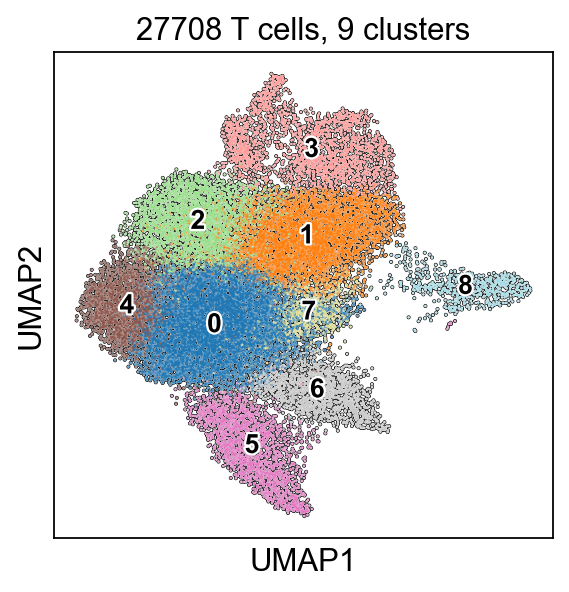

... storing 'cluster' as categorical


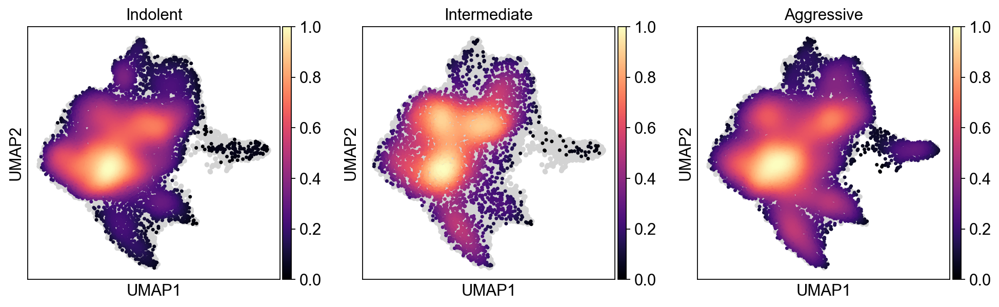

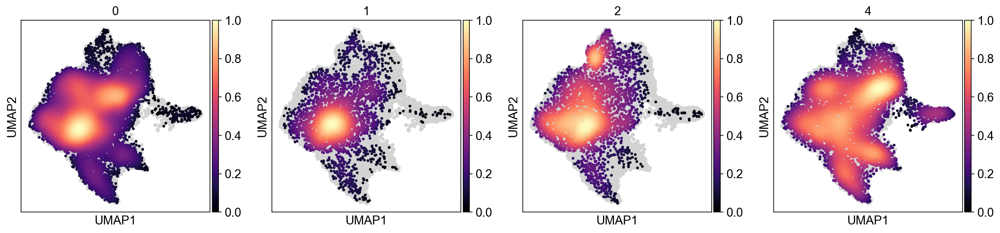

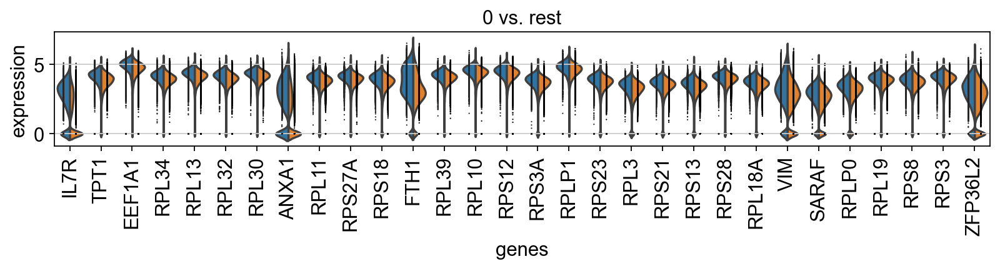

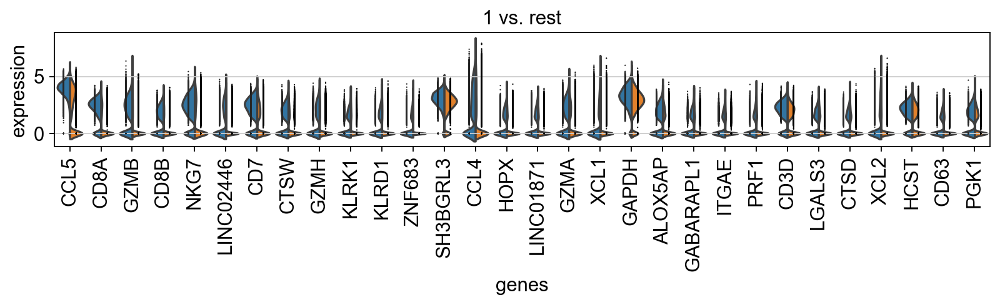

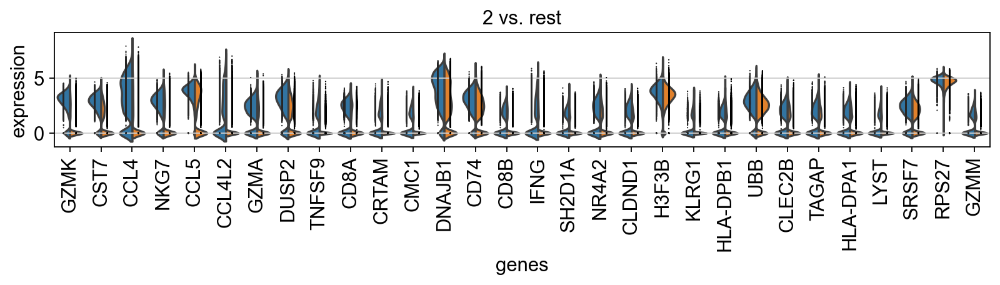

...

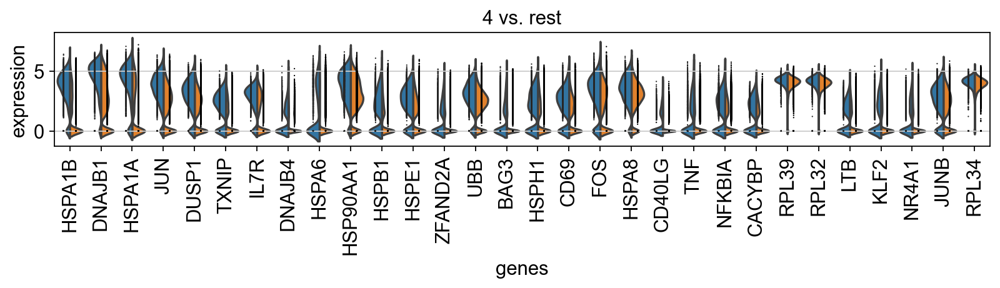

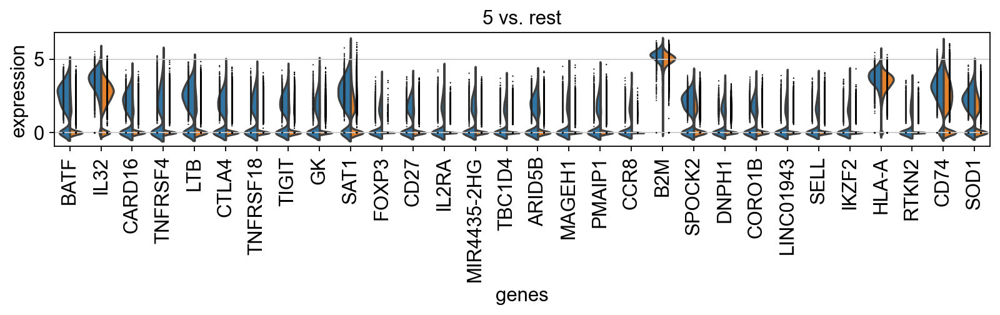

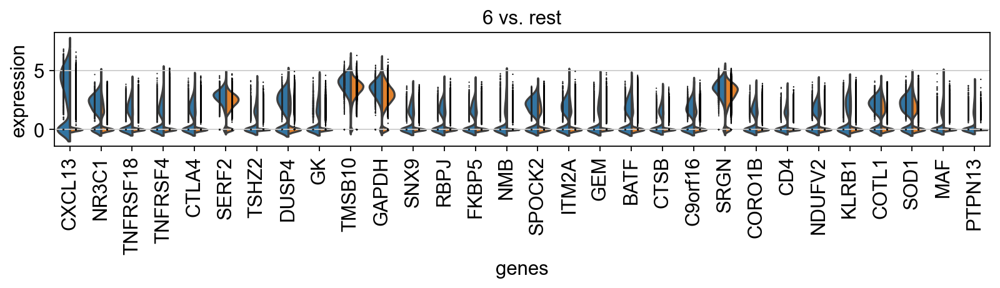

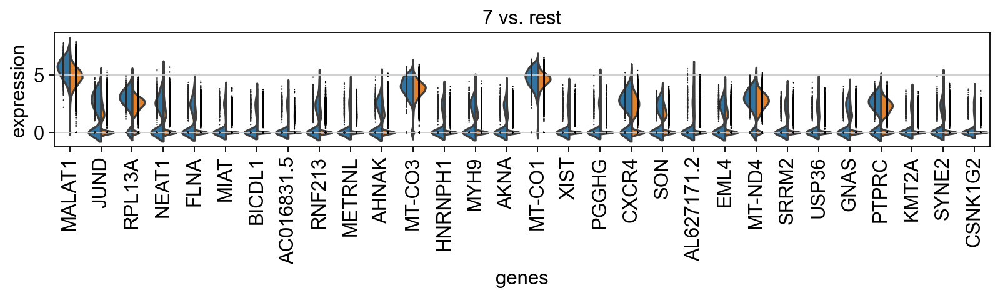

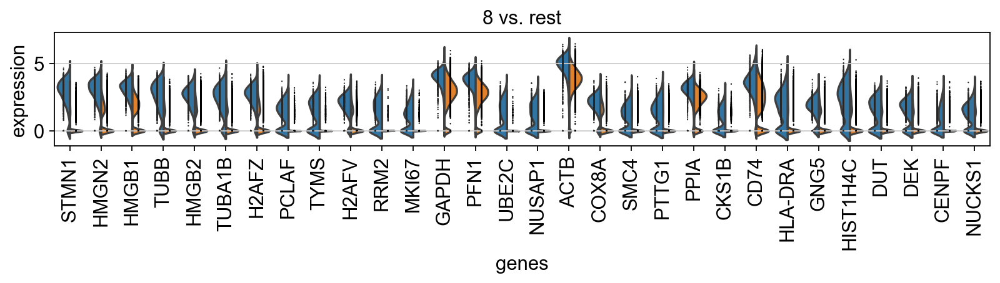

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Indolent vs. Aggressive: Mann-Whitney-Wilcoxon test two-sided, P_val:1.747e-01 U_stat=3.100e+01
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Indolent vs. Aggressive: Mann-Whitney-Wilcoxon test two-sided, P_val:9.431e-01 U_stat=2.200e+01
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Indolent vs. Aggressive: Mann-Whitney-Wilcoxon test two-sided, P_val:4.320e-01 U_stat=2.700e+01
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <

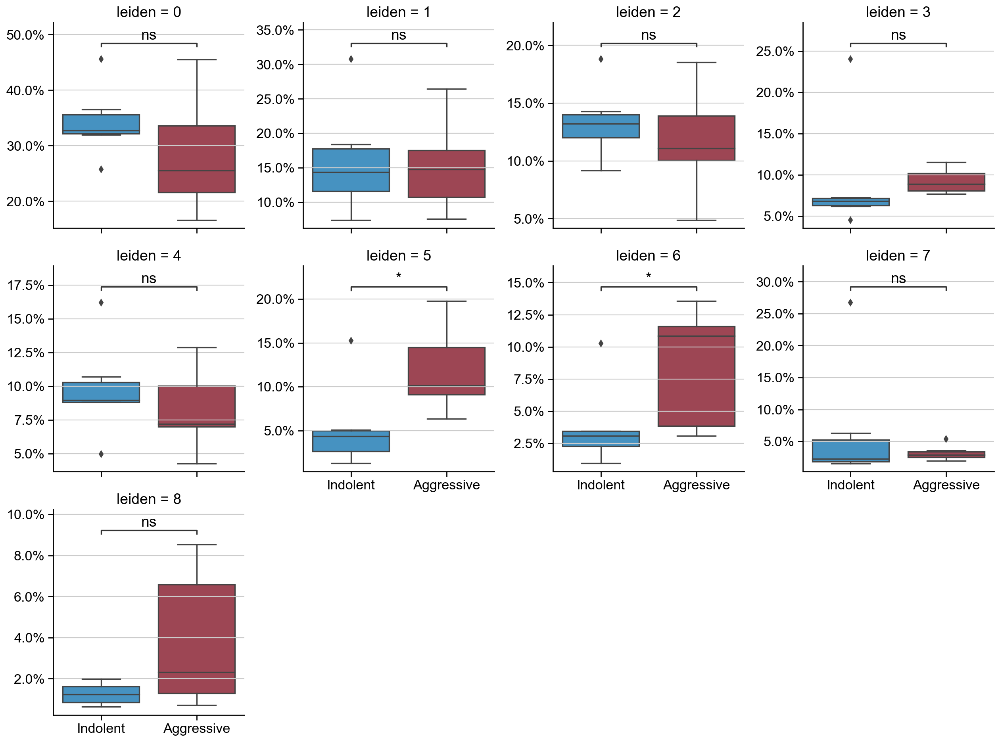

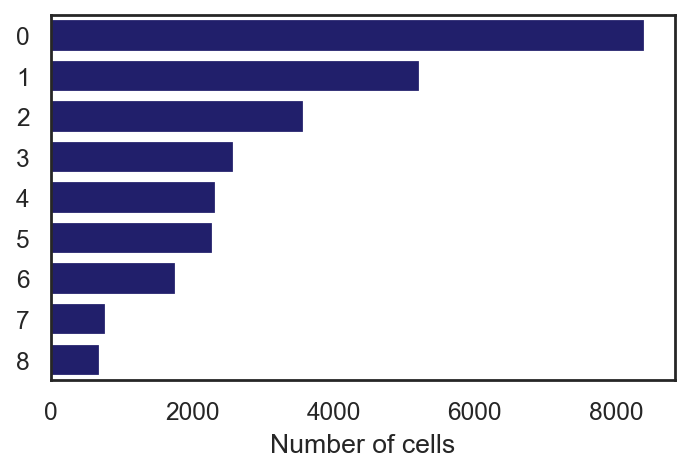

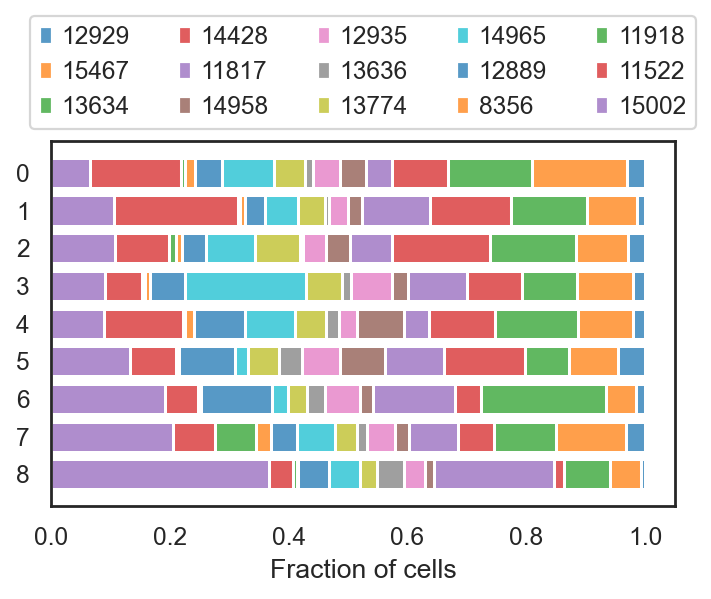

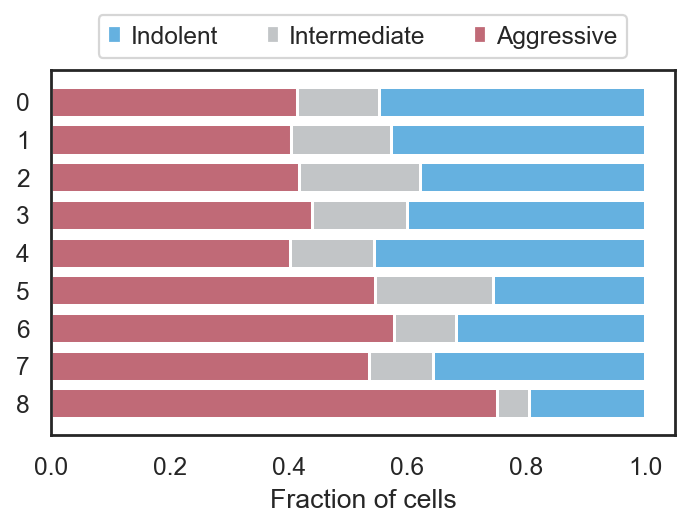

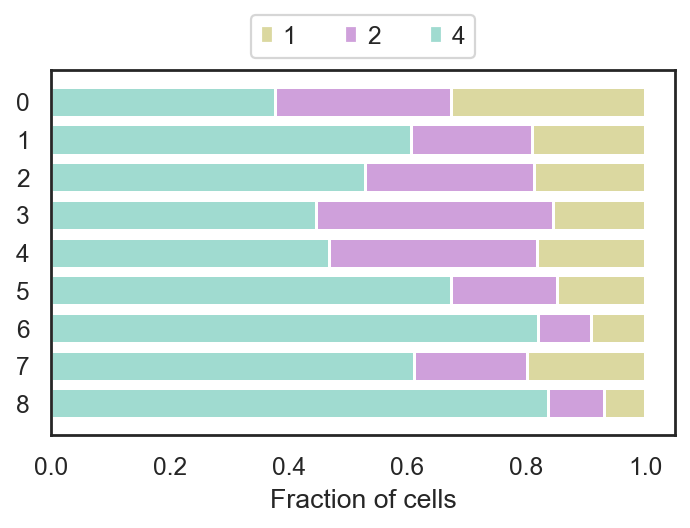

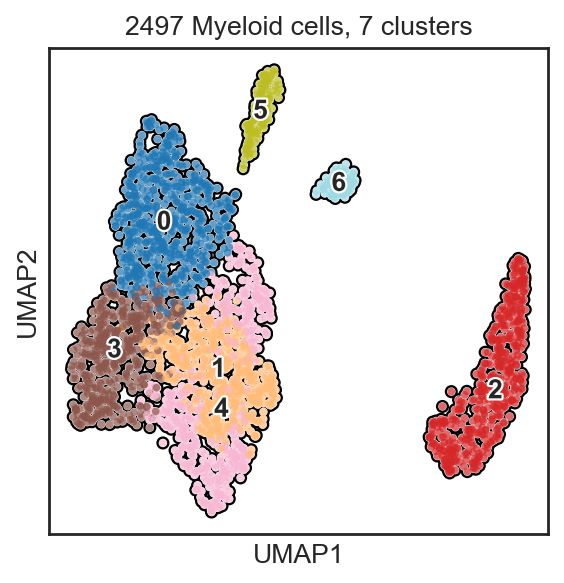

... storing 'cluster' as categorical


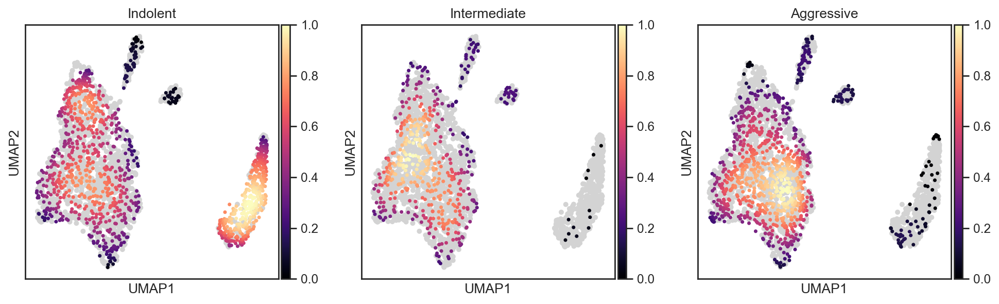

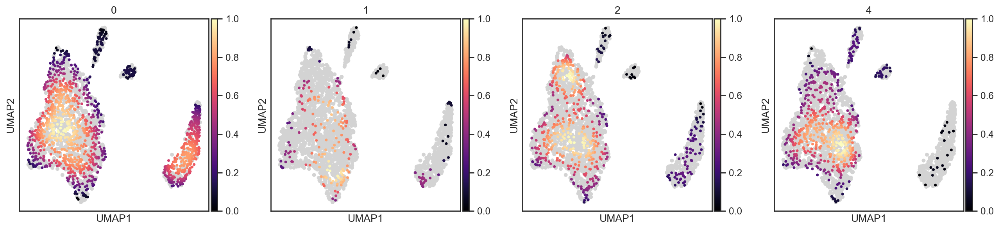

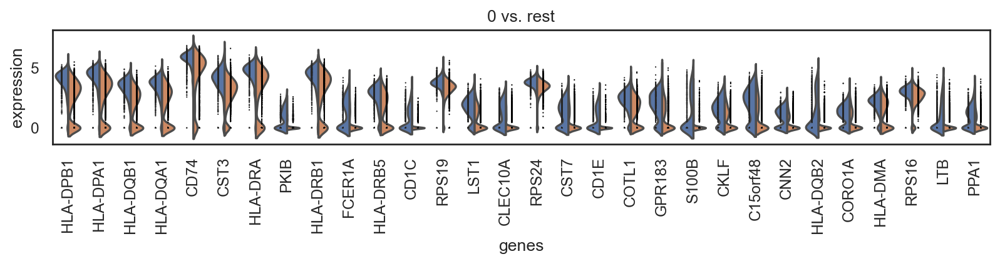

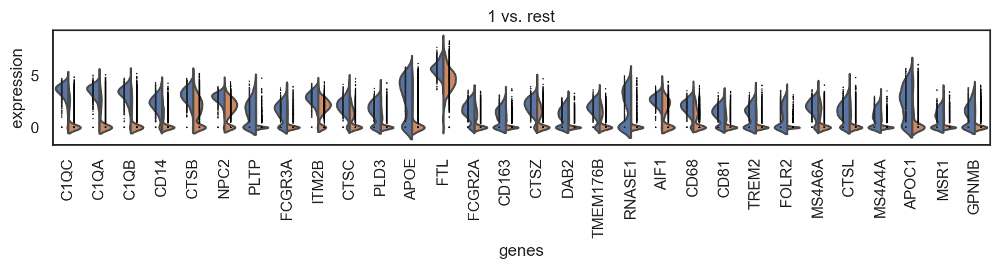

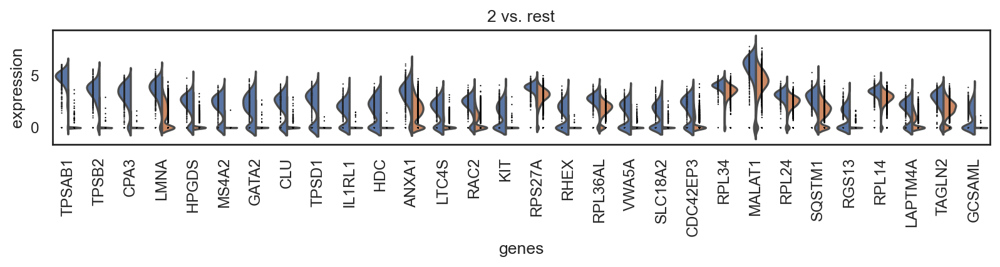

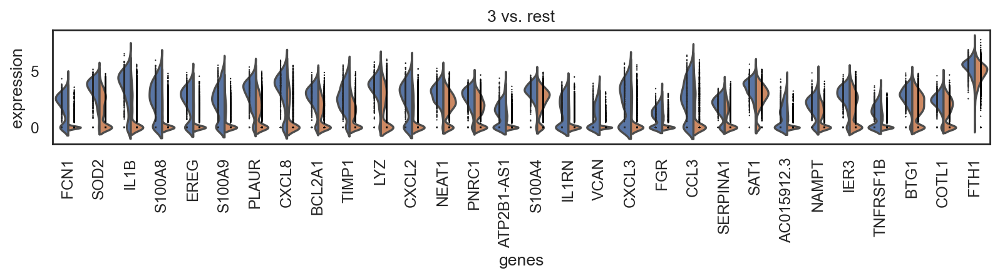

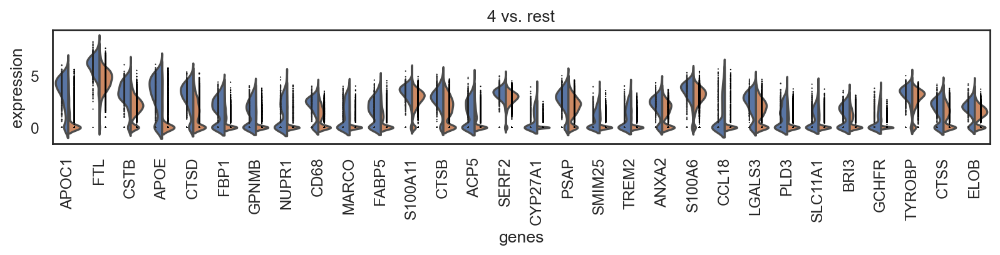

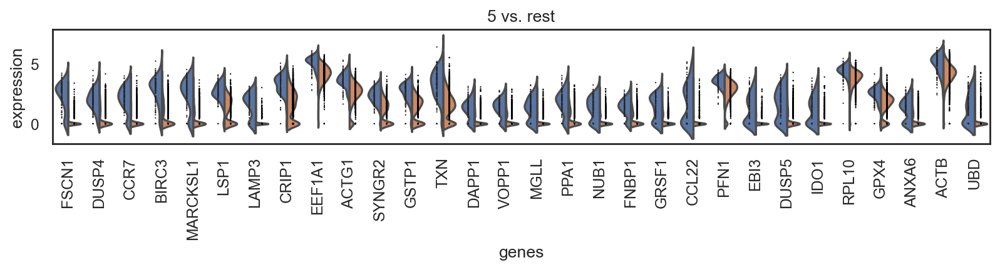

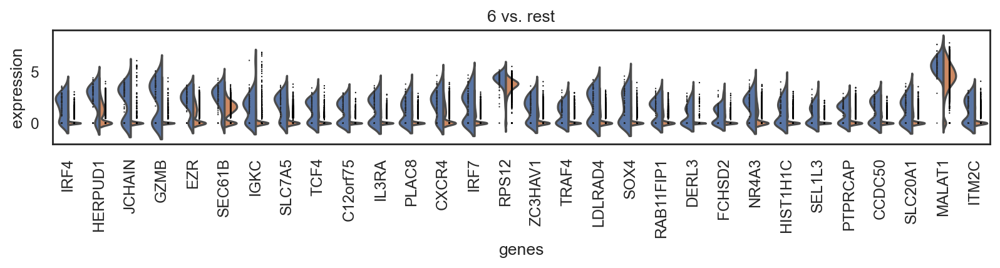

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Indolent vs. Aggressive: Mann-Whitney-Wilcoxon test two-sided, P_val:5.203e-01 U_stat=2.600e+01
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Indolent vs. Aggressive: Mann-Whitney-Wilcoxon test two-sided, P_val:3.832e-02 U_stat=6.000e+00
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Indolent vs. Aggressive: Mann-Whitney-Wilcoxon test two-sided, P_val:6.151e-01 U_stat=2.500e+01
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <

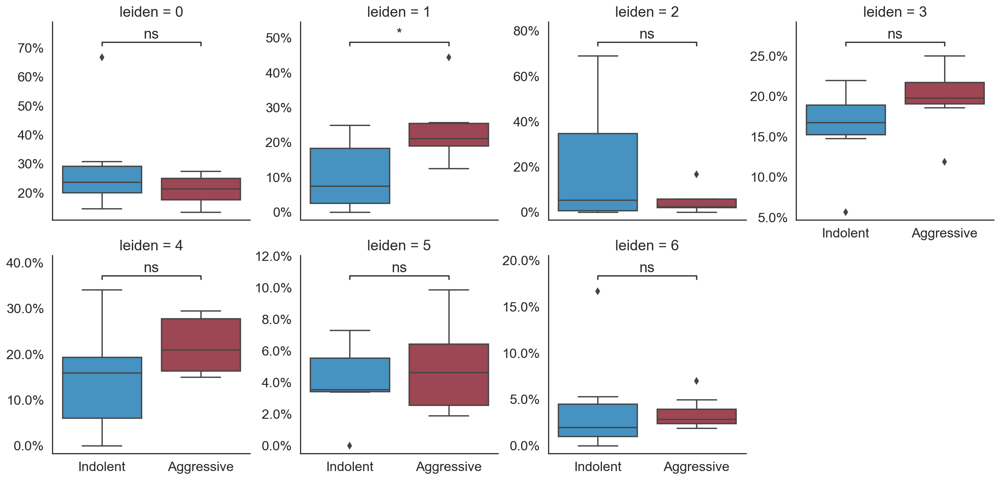

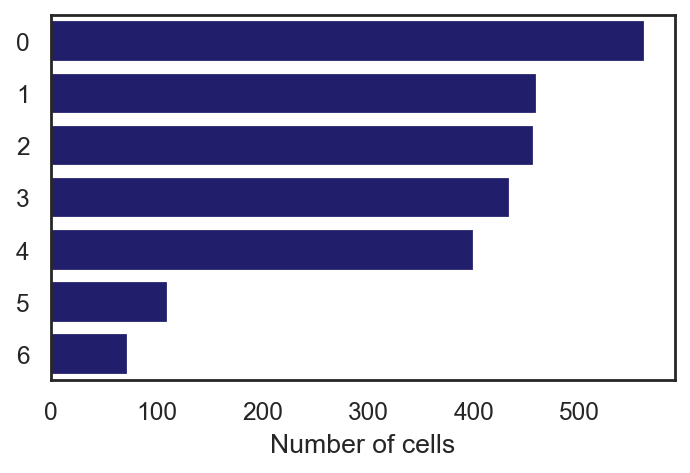

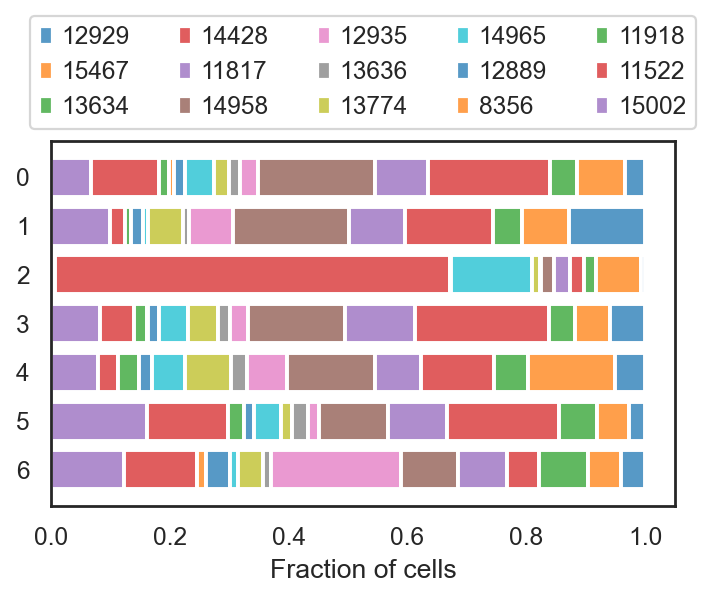

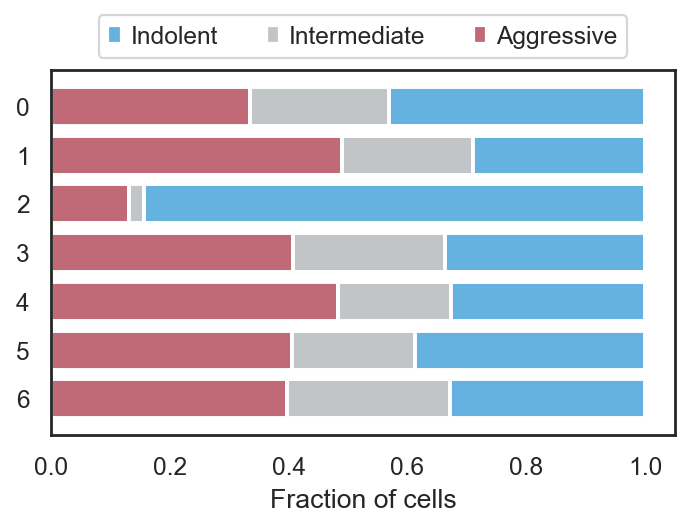

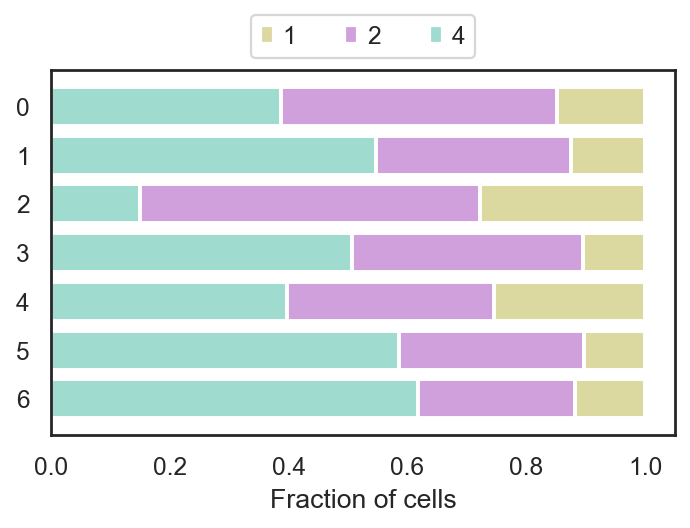

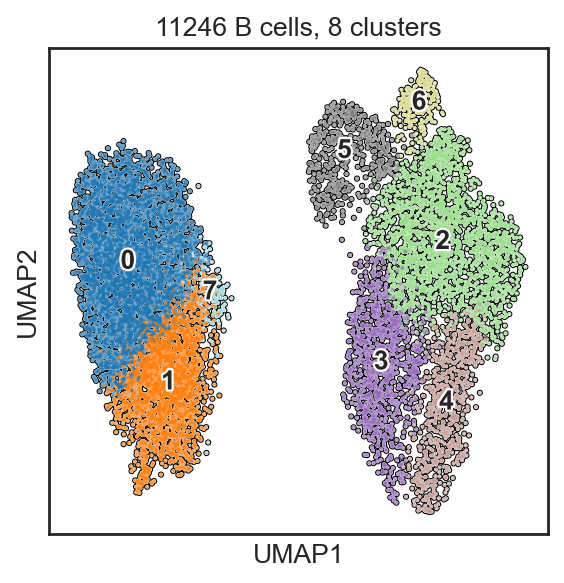

... storing 'cluster' as categorical


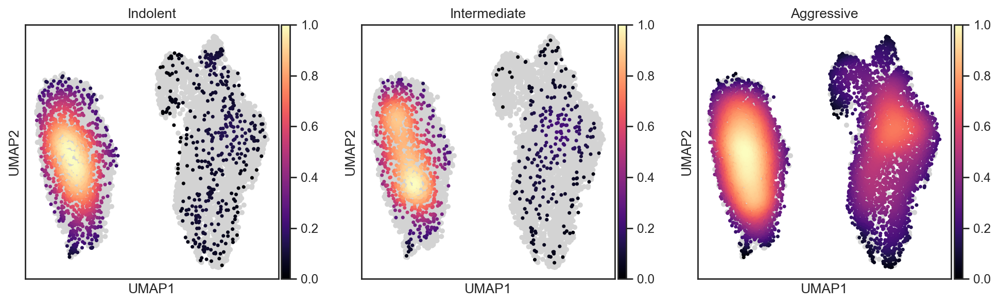

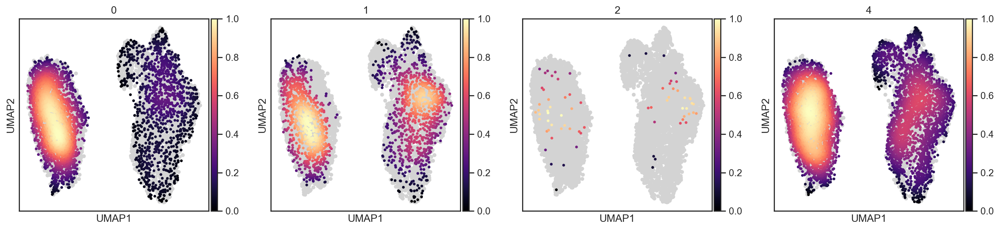

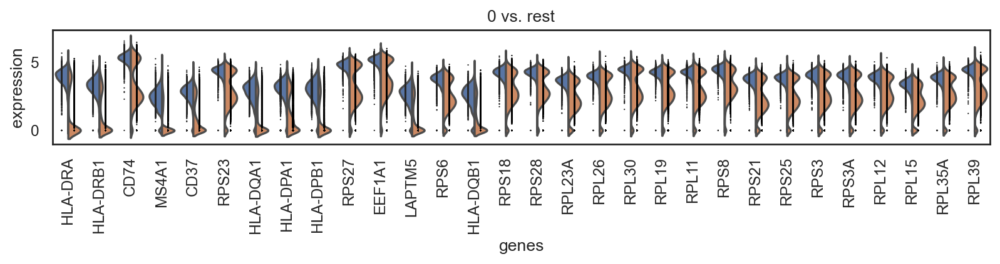

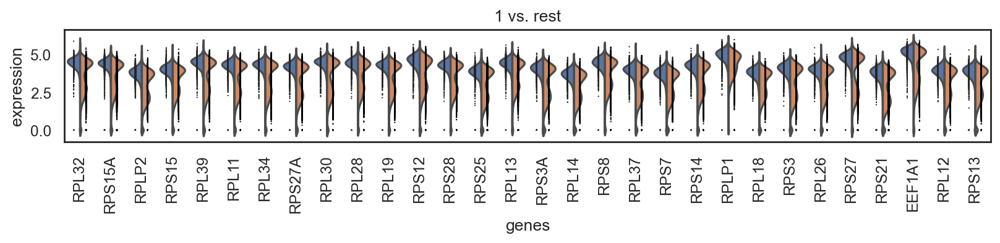

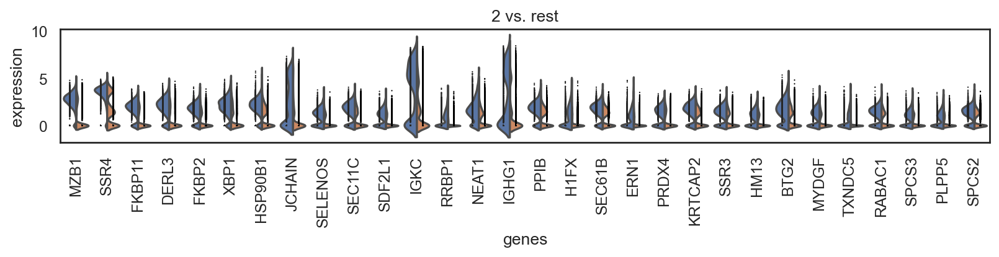

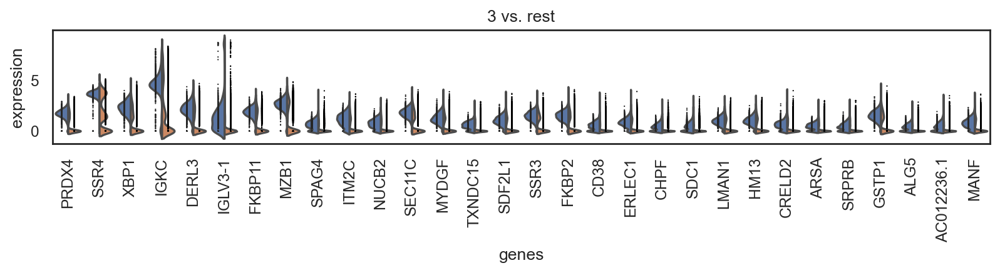

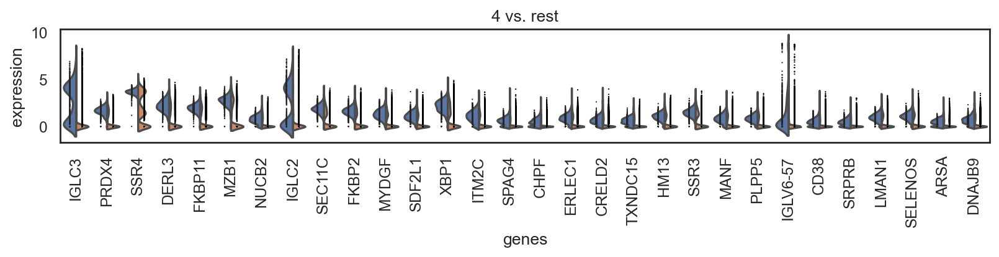

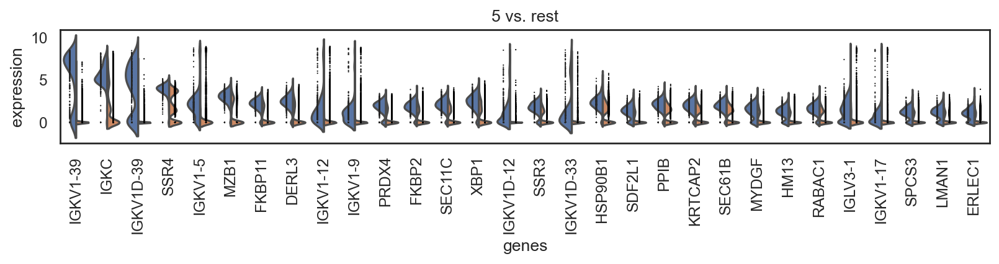

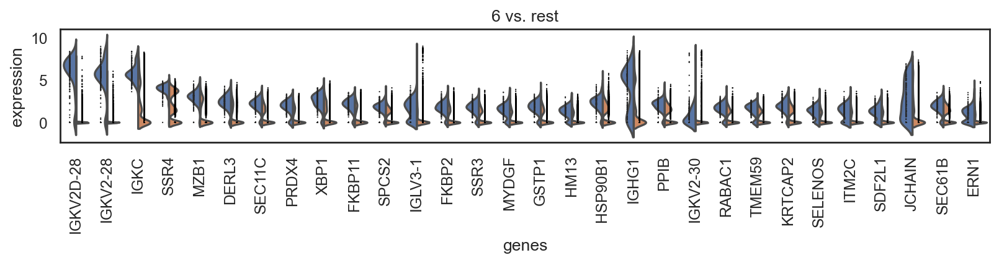

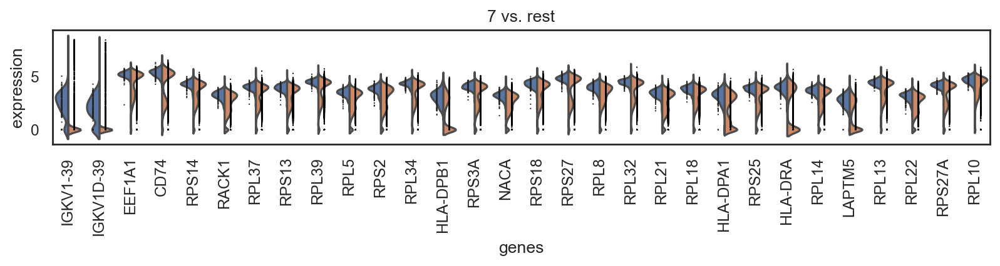

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Indolent vs. Aggressive: Mann-Whitney-Wilcoxon test two-sided, P_val:1.242e-02 U_stat=3.900e+01
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Indolent vs. Aggressive: Mann-Whitney-Wilcoxon test two-sided, P_val:9.431e-01 U_stat=2.200e+01
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Indolent vs. Aggressive: Mann-Whitney-Wilcoxon test two-sided, P_val:2.240e-01 U_stat=1.200e+01
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <

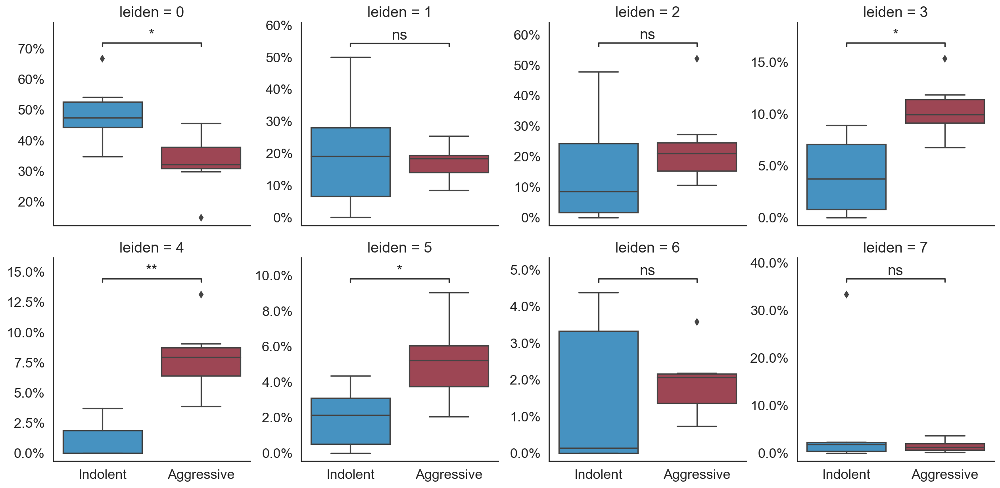

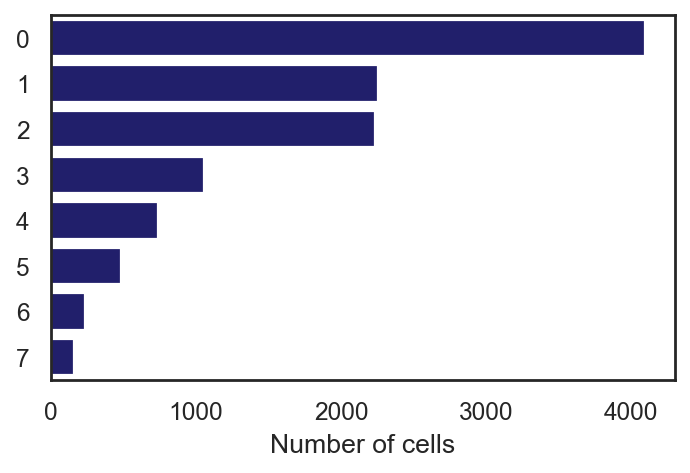

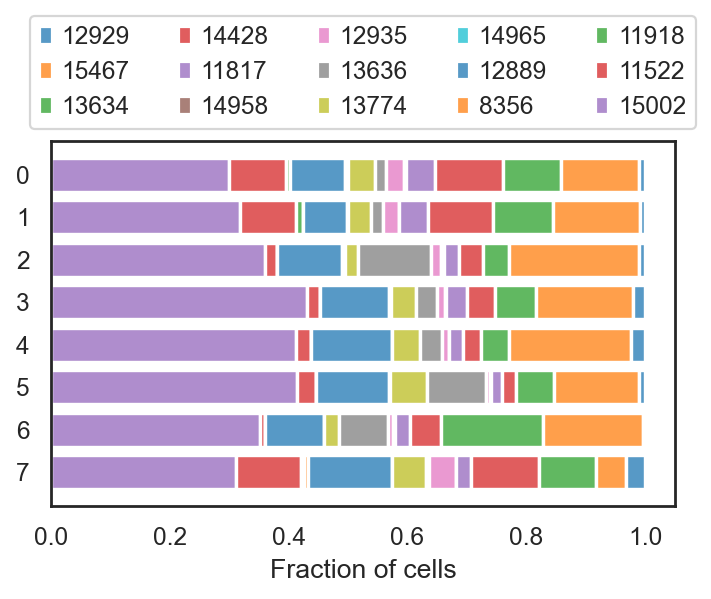

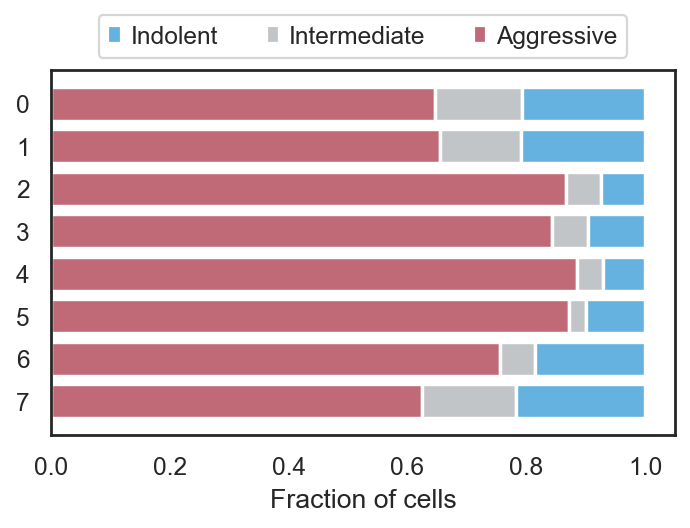

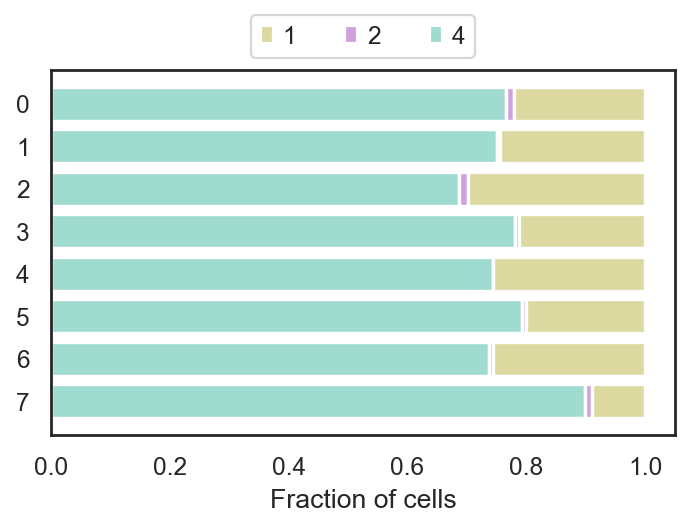

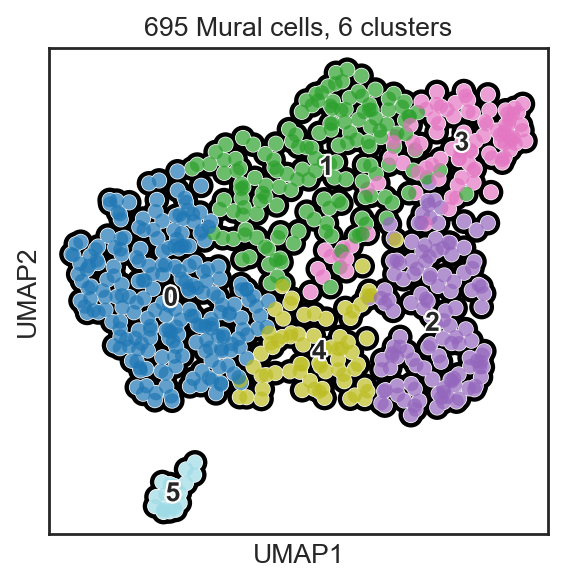

... storing 'cluster' as categorical


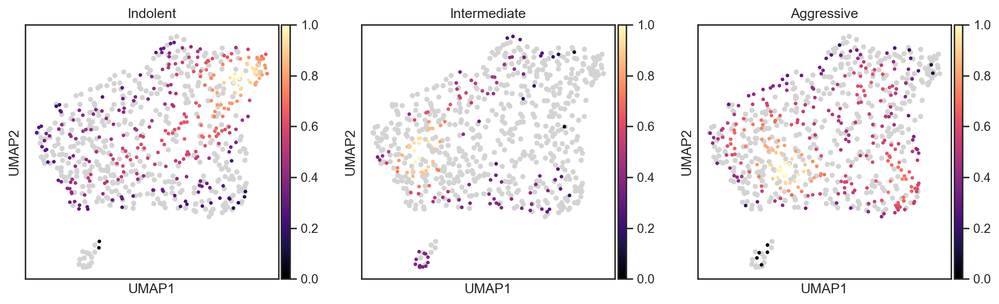

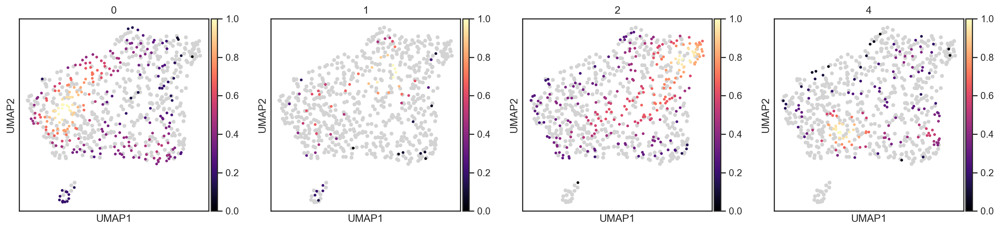

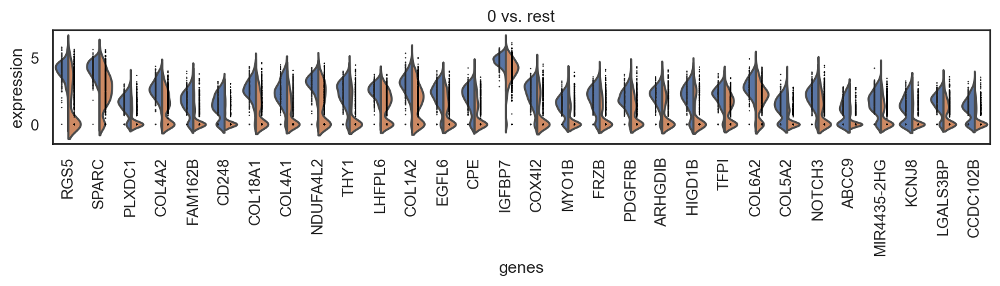

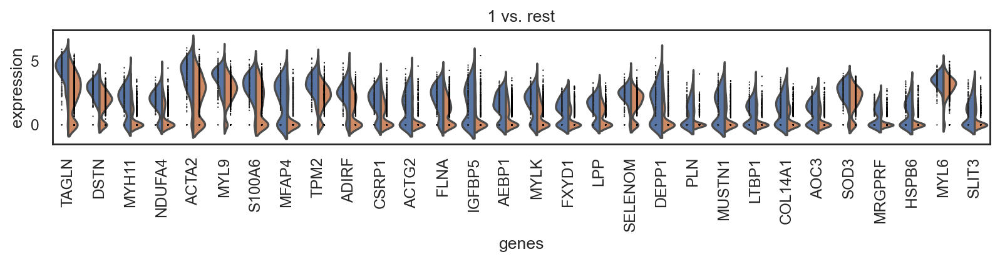

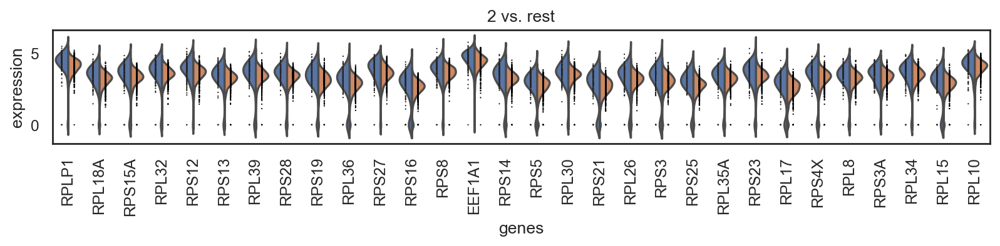

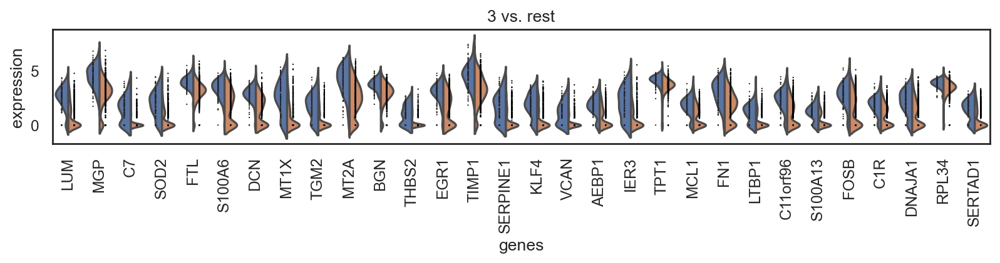

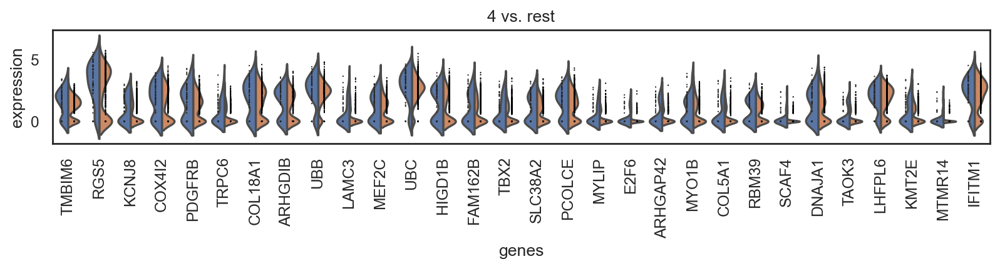

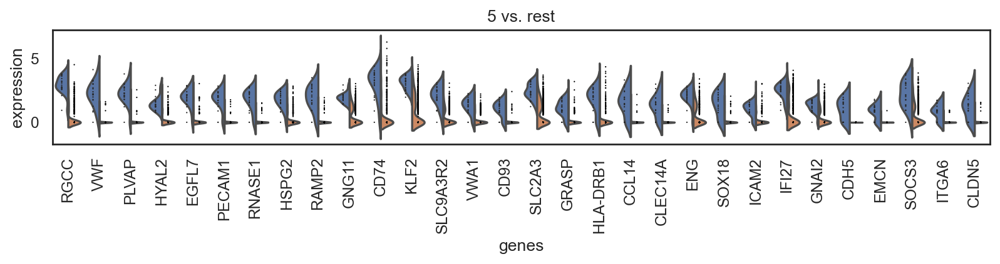

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Indolent vs. Aggressive: Mann-Whitney-Wilcoxon test two-sided, P_val:5.699e-01 U_stat=1.050e+01
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Indolent vs. Aggressive: Mann-Whitney-Wilcoxon test two-sided, P_val:5.083e-01 U_stat=1.800e+01
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Indolent vs. Aggressive: Mann-Whitney-Wilcoxon test two-sided, P_val:2.183e-01 U_stat=7.000e+00
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <

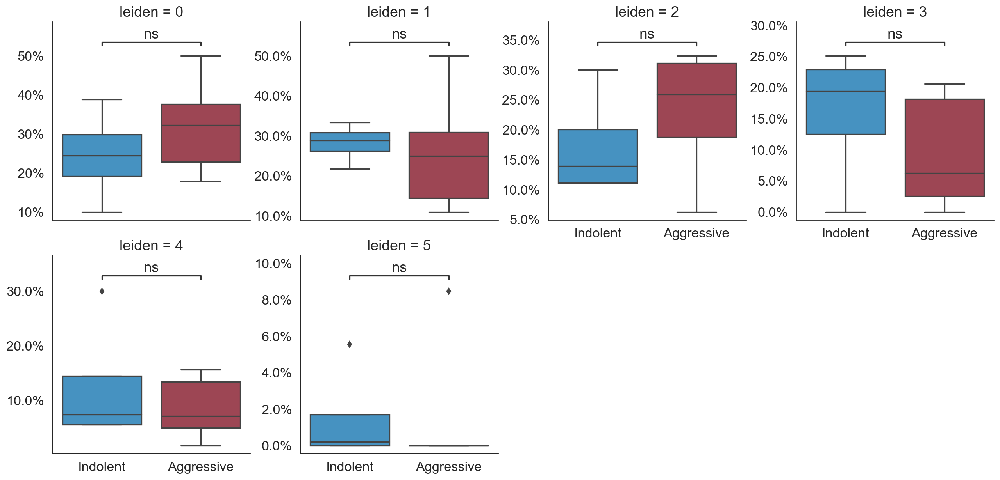

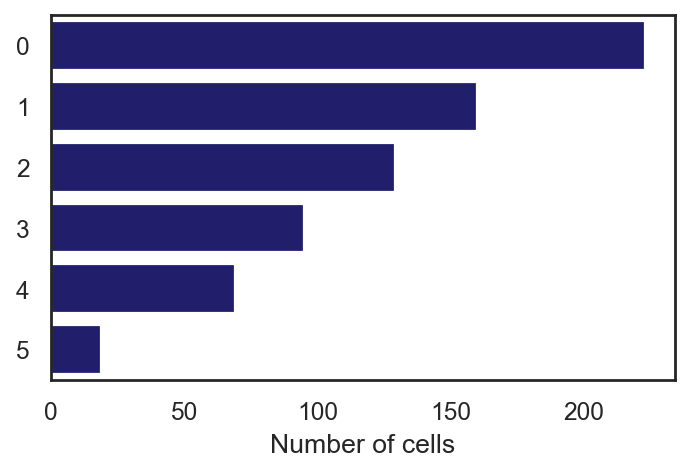

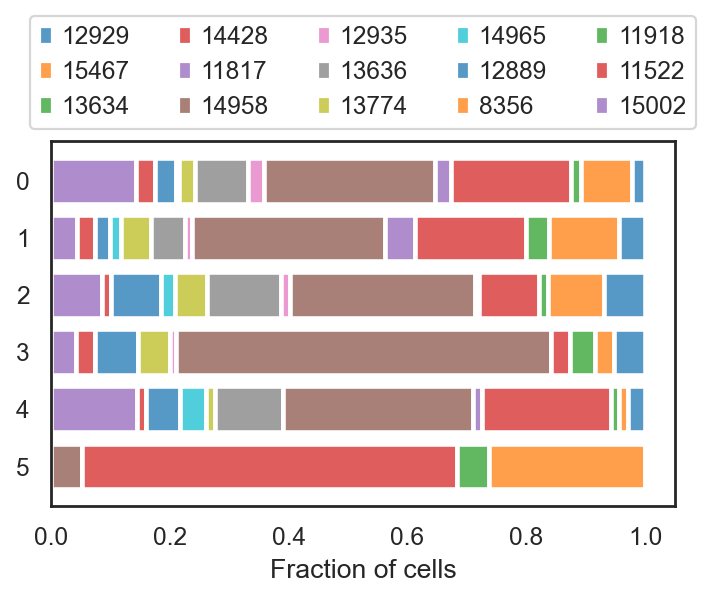

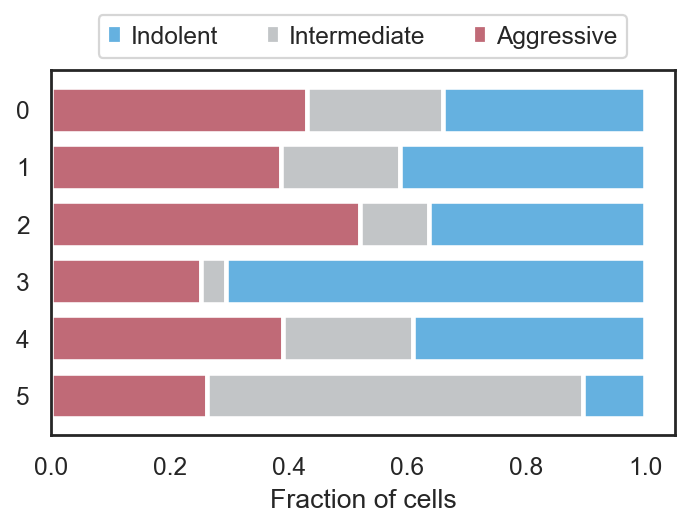

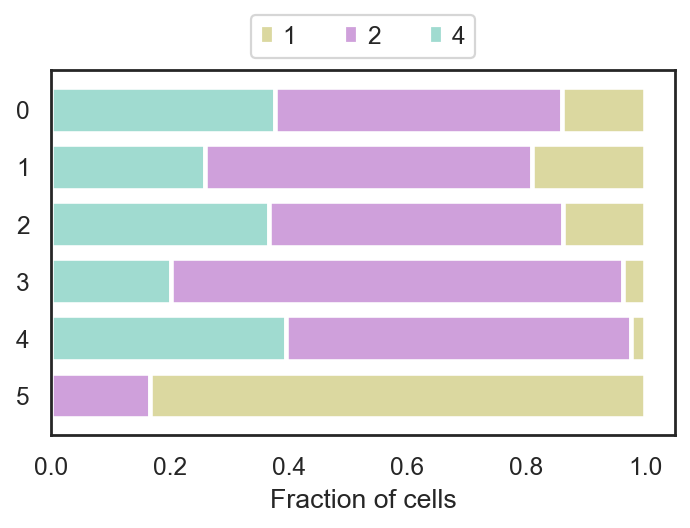

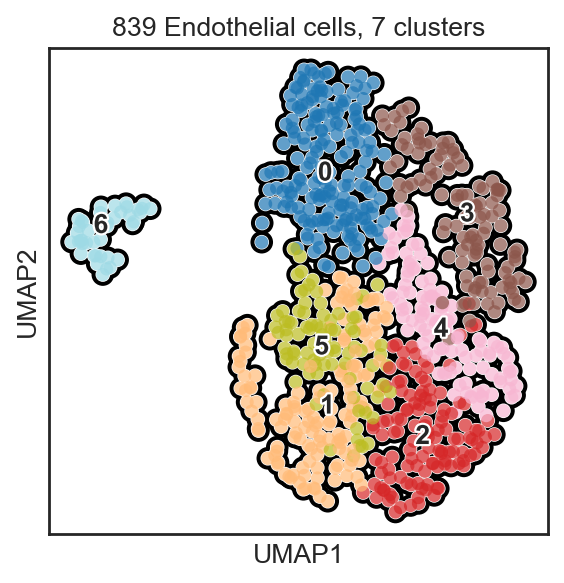

... storing 'cluster' as categorical


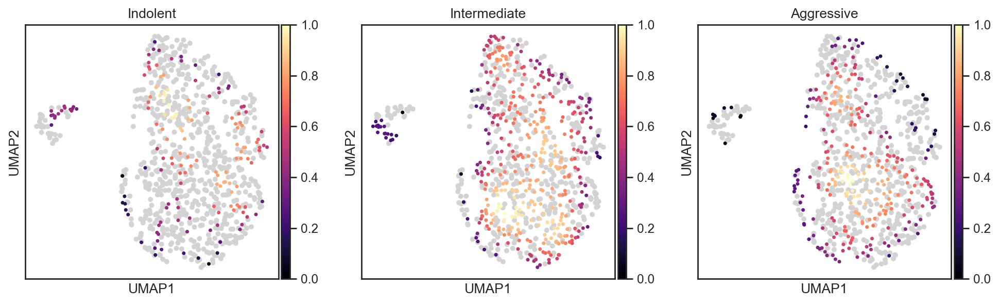

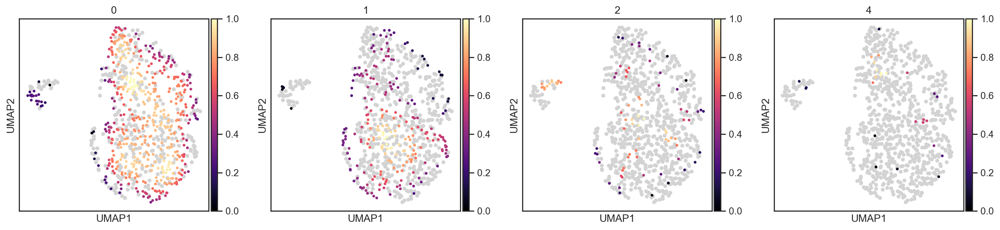

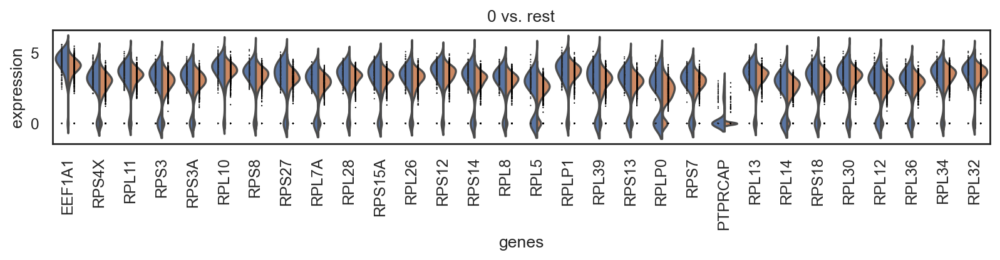

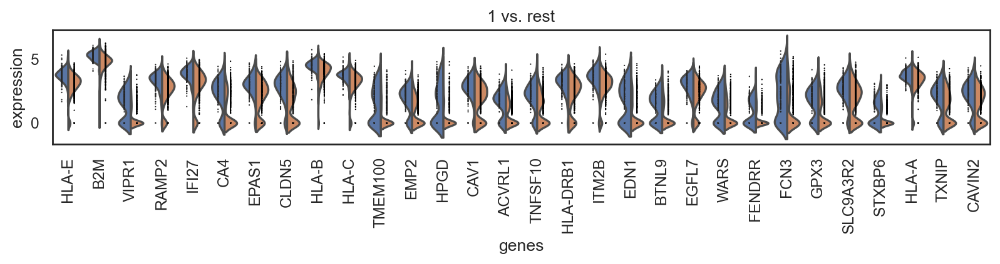

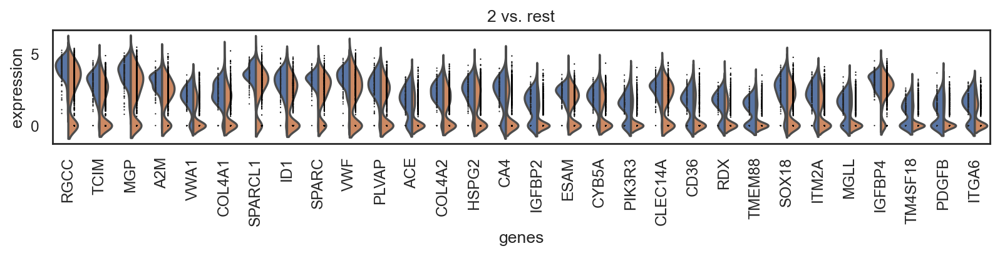

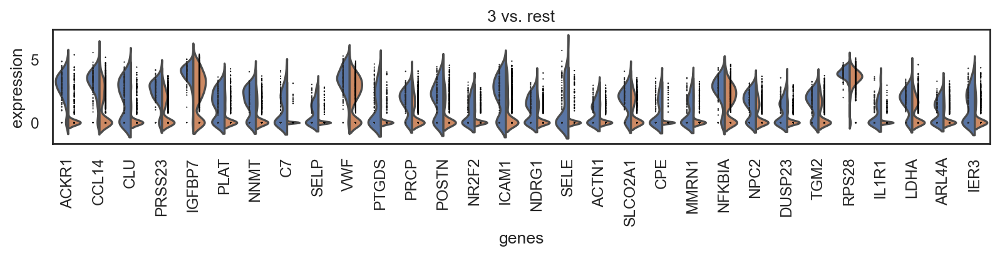

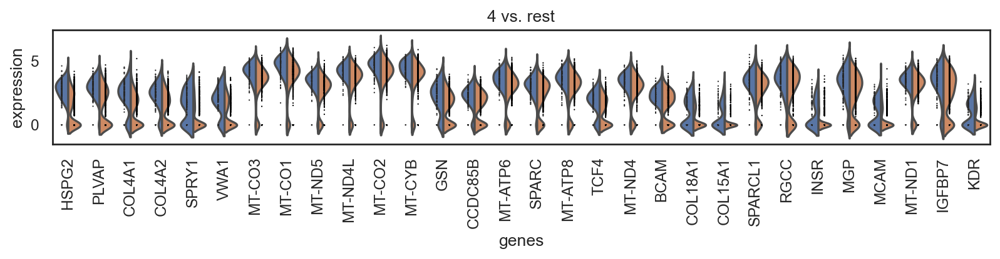

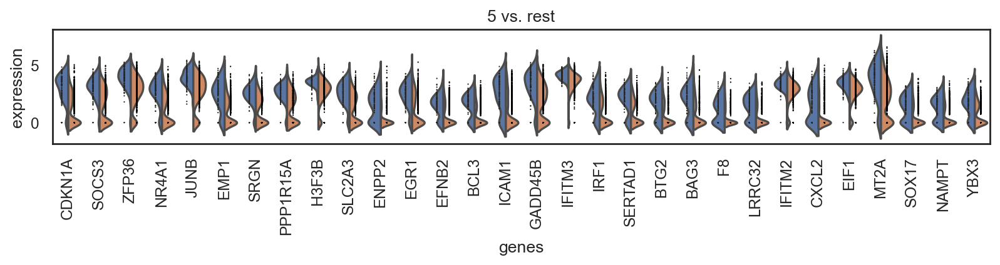

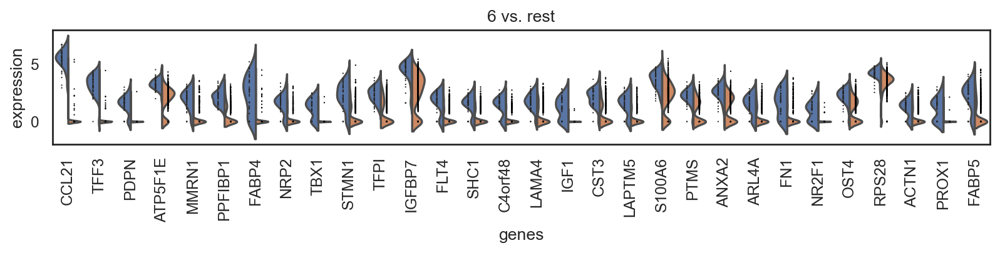

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Indolent vs. Aggressive: Mann-Whitney-Wilcoxon test two-sided, P_val:3.951e-01 U_stat=9.000e+00
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Indolent vs. Aggressive: Mann-Whitney-Wilcoxon test two-sided, P_val:1.469e-01 U_stat=2.200e+01
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Indolent vs. Aggressive: Mann-Whitney-Wilcoxon test two-sided, P_val:2.964e-01 U_stat=8.000e+00
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <

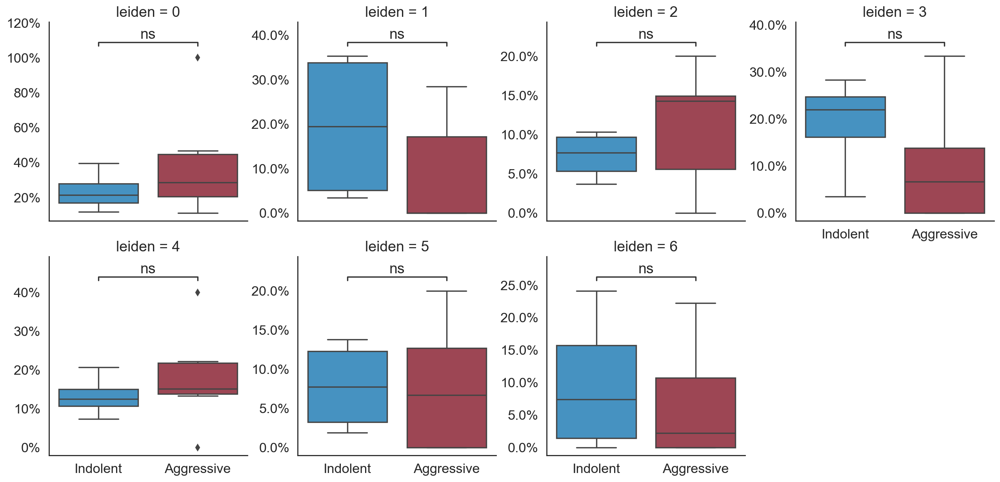

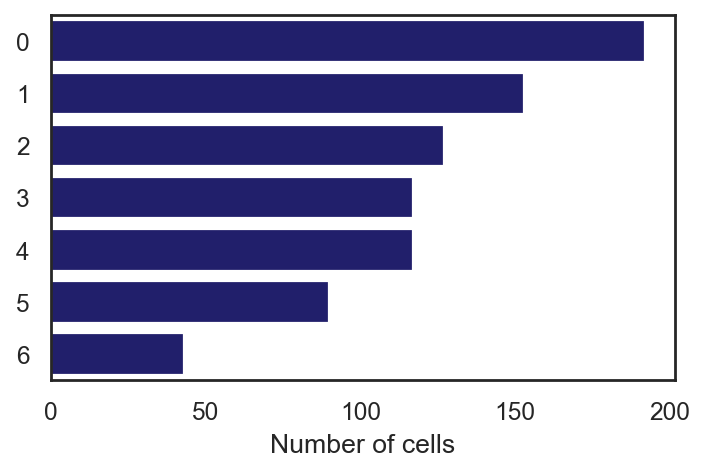

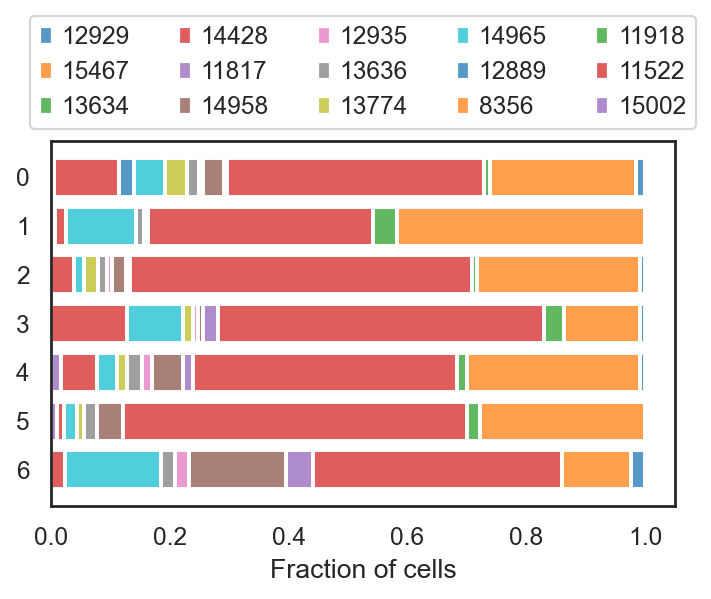

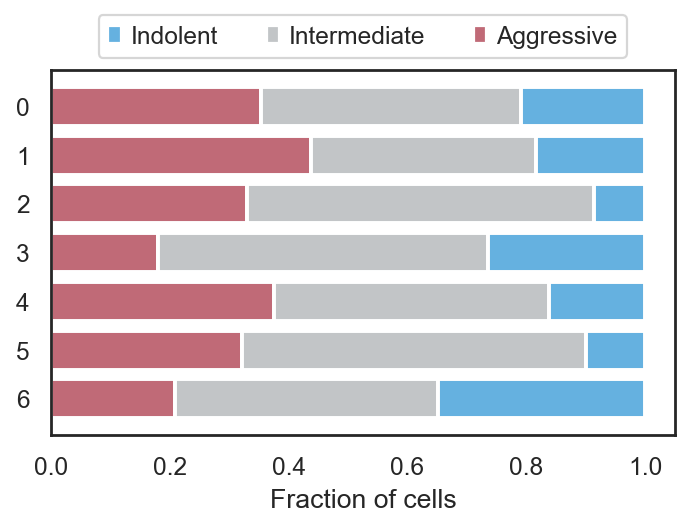

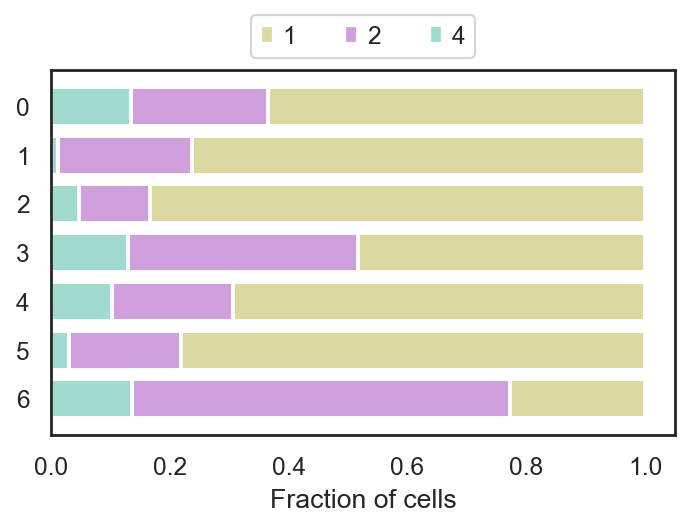

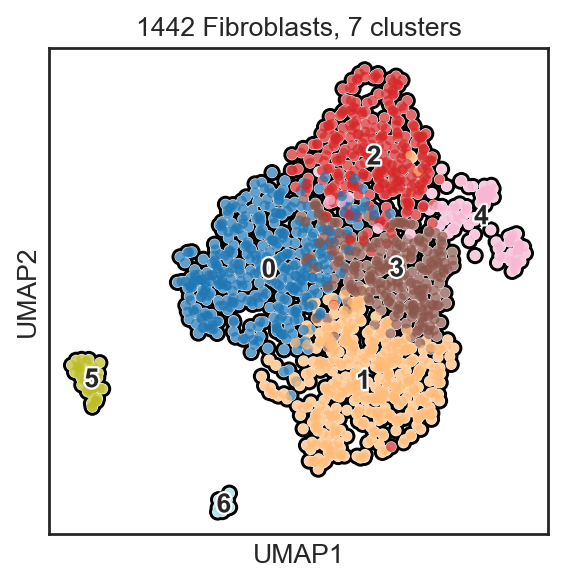

... storing 'cluster' as categorical


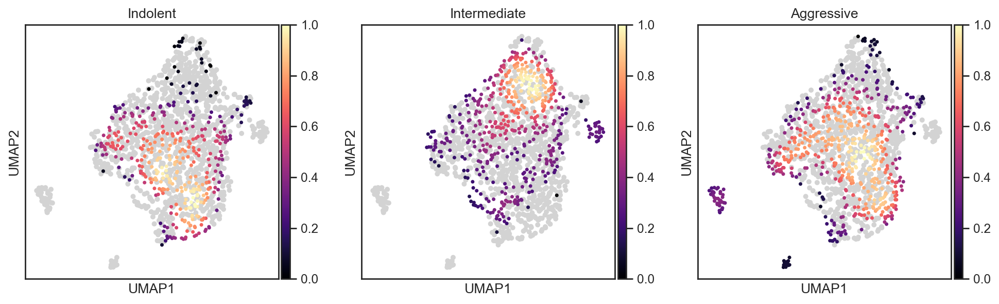

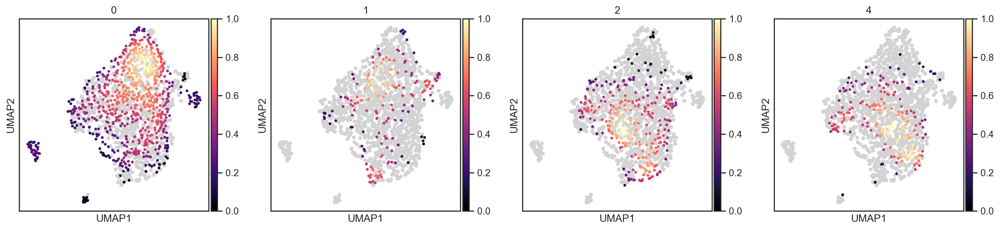

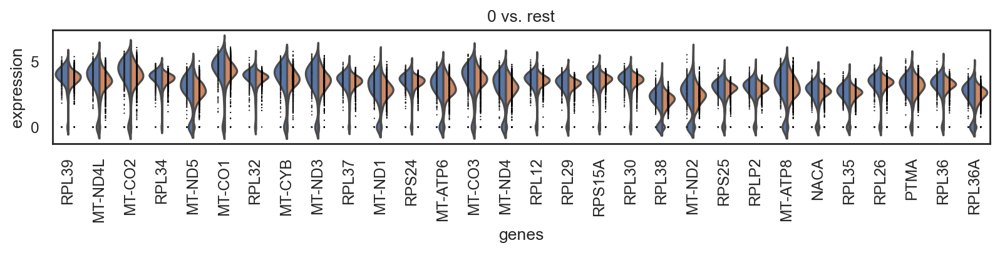

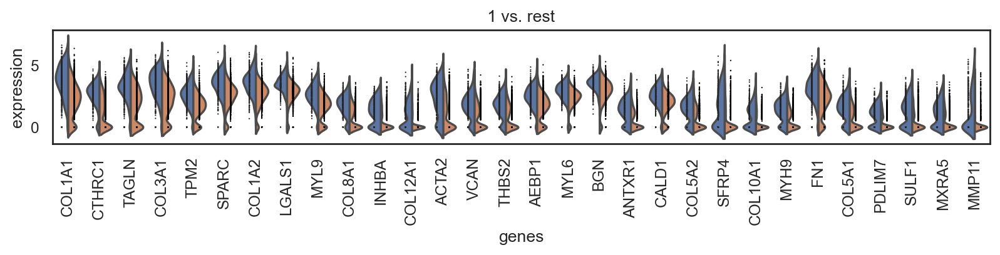

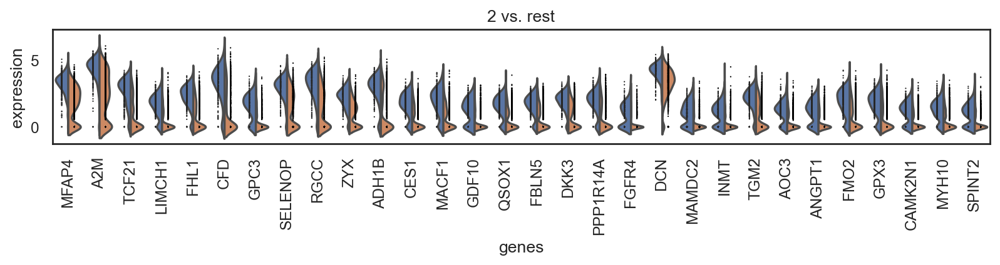

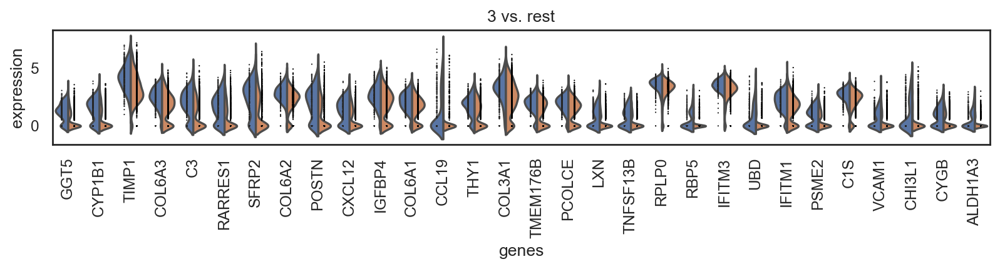

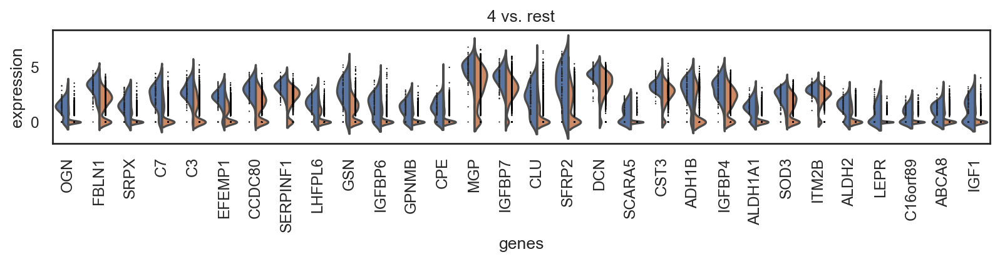

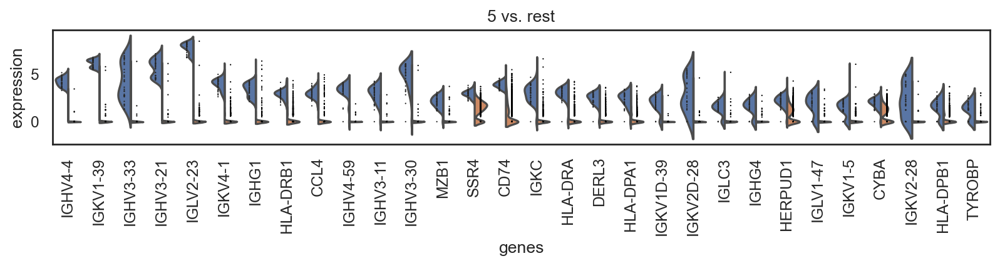

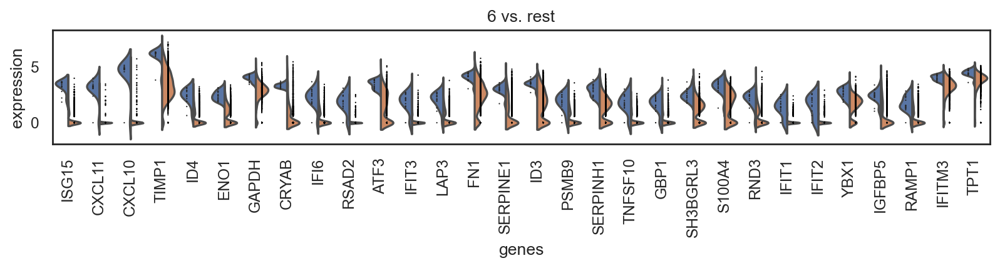

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Indolent vs. Aggressive: Mann-Whitney-Wilcoxon test two-sided, P_val:7.768e-01 U_stat=1.200e+01
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Indolent vs. Aggressive: Mann-Whitney-Wilcoxon test two-sided, P_val:1.082e-01 U_stat=2.300e+01
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Indolent vs. Aggressive: Mann-Whitney-Wilcoxon test two-sided, P_val:5.083e-01 U_stat=1.800e+01
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <

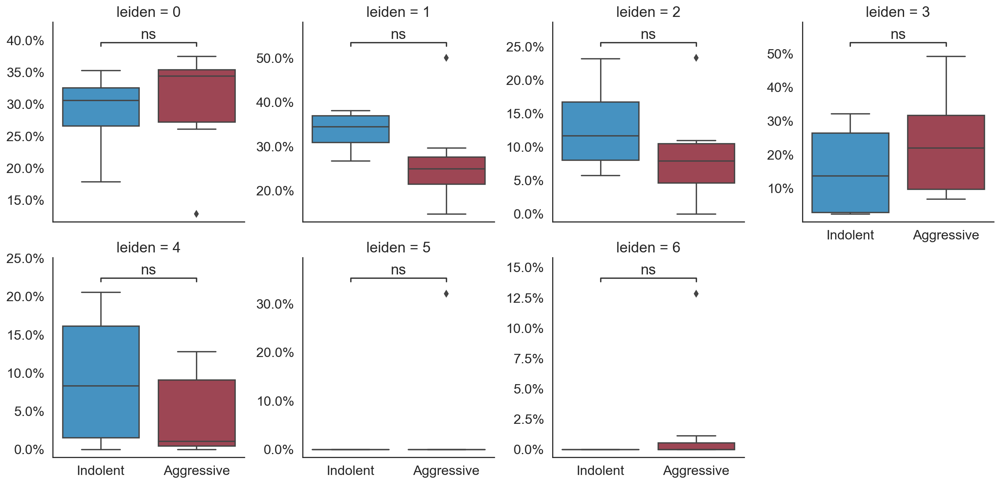

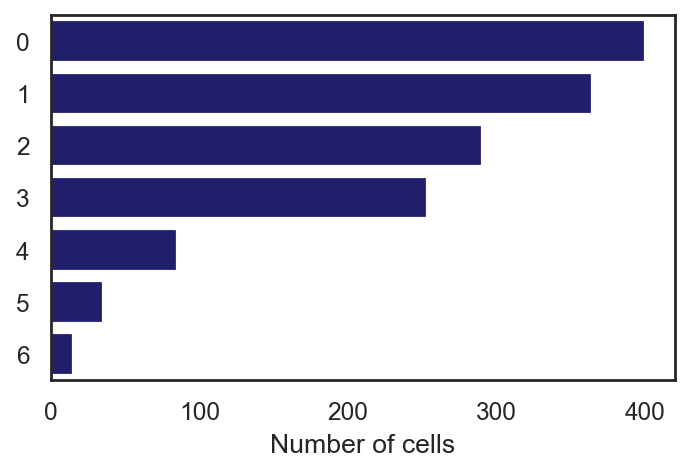

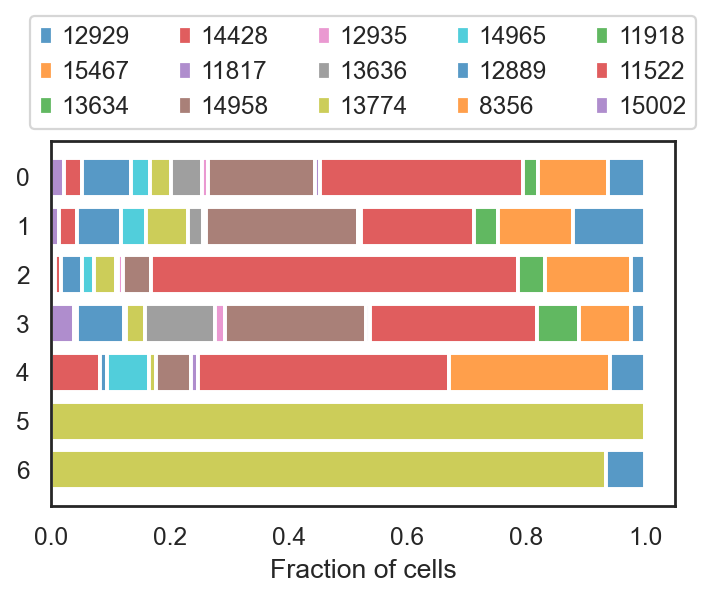

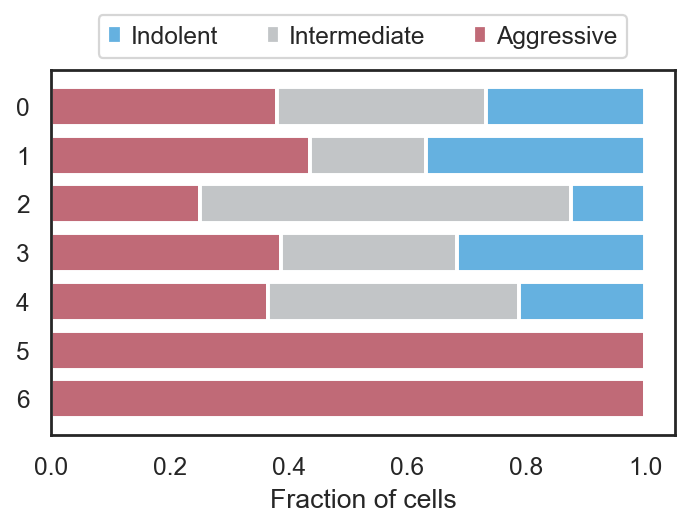

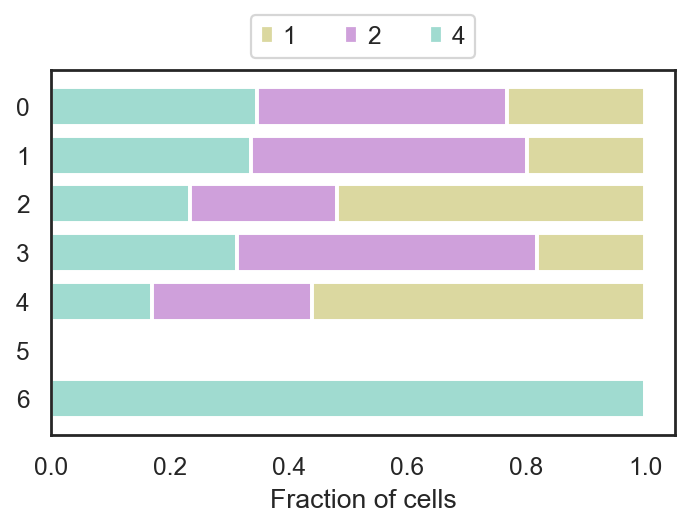

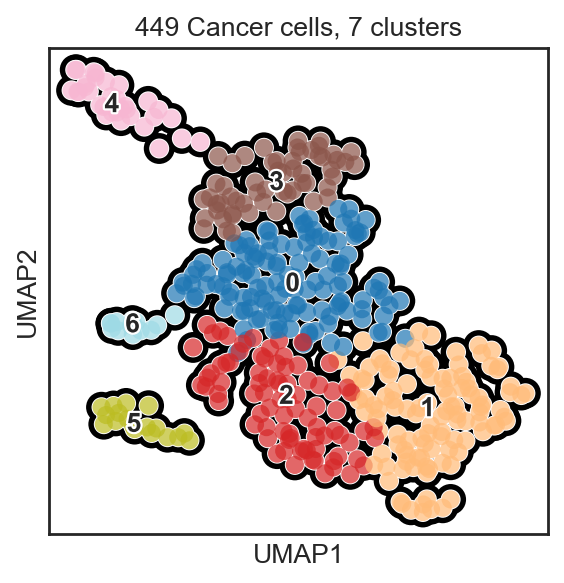

... storing 'cluster' as categorical


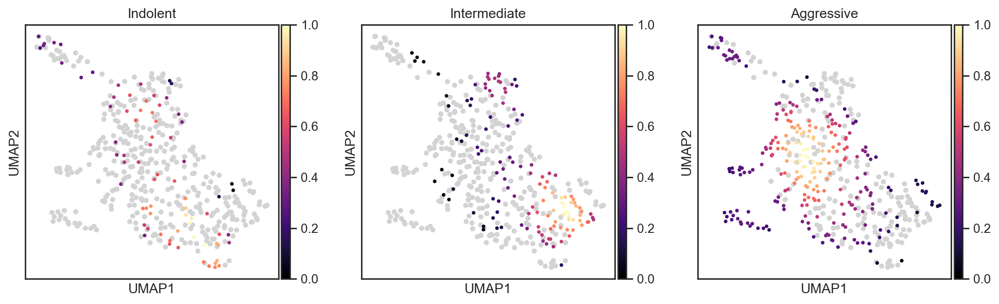

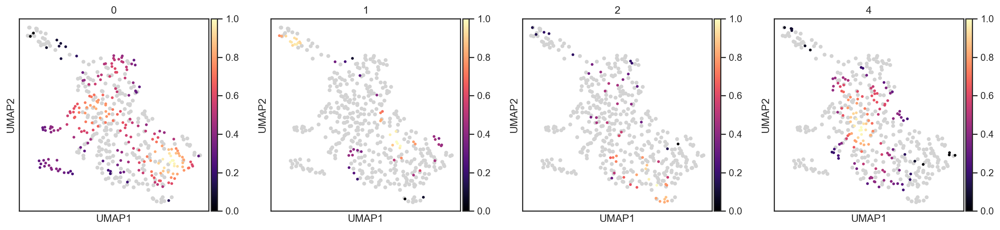

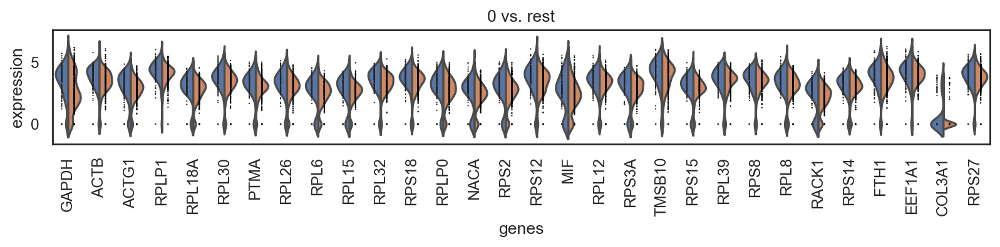

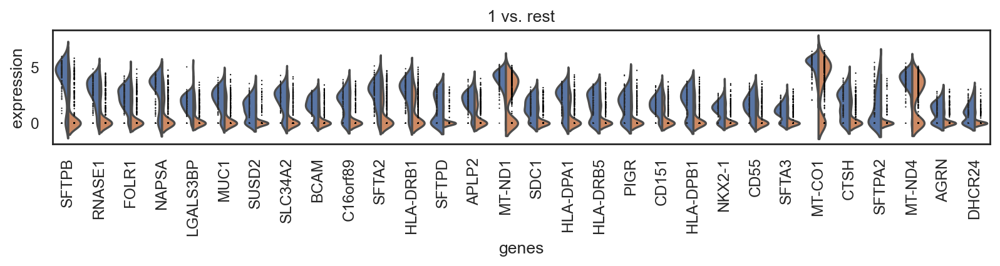

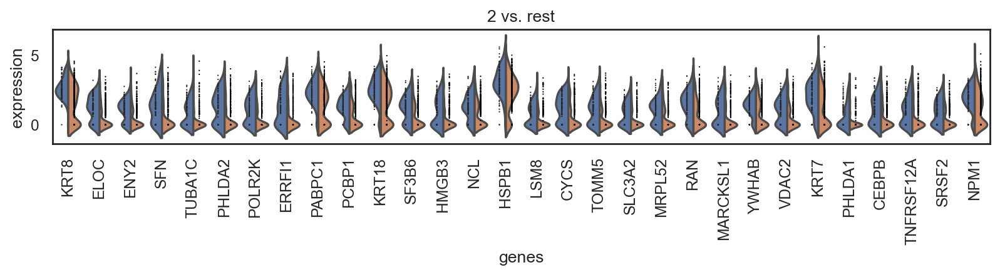

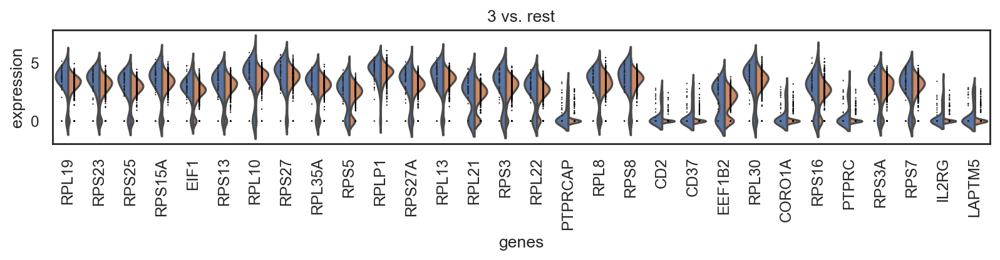

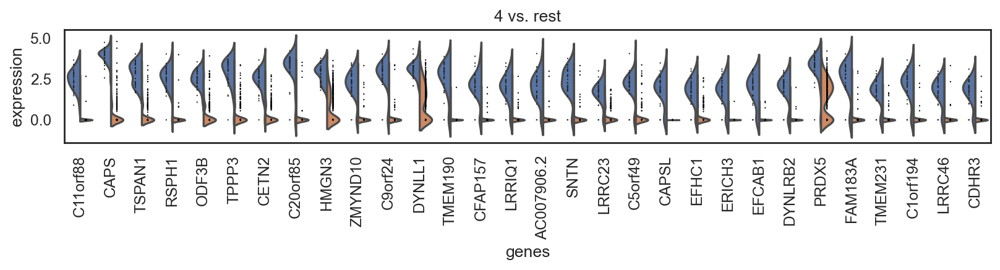

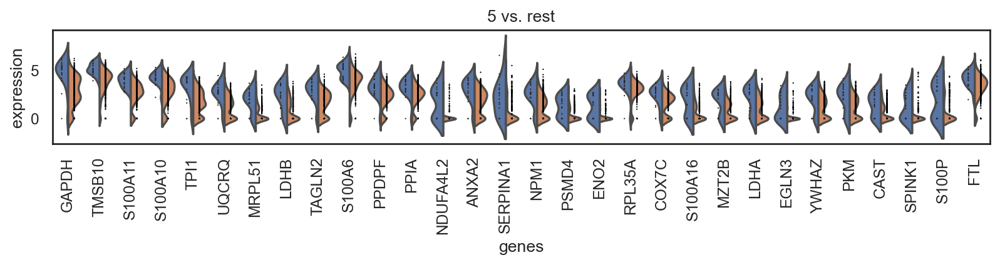

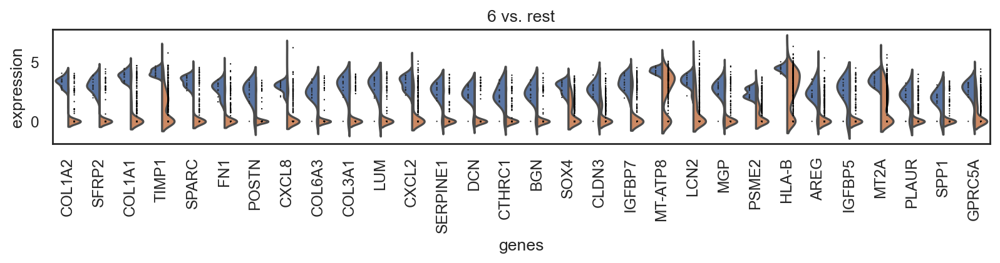

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Indolent vs. Aggressive: Mann-Whitney-Wilcoxon test two-sided, P_val:3.476e-02 U_stat=4.000e+00
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Indolent vs. Aggressive: Mann-Whitney-Wilcoxon test two-sided, P_val:2.192e-01 U_stat=2.550e+01
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Indolent vs. Aggressive: Mann-Whitney-Wilcoxon test two-sided, P_val:1.432e-01 U_stat=8.000e+00
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <

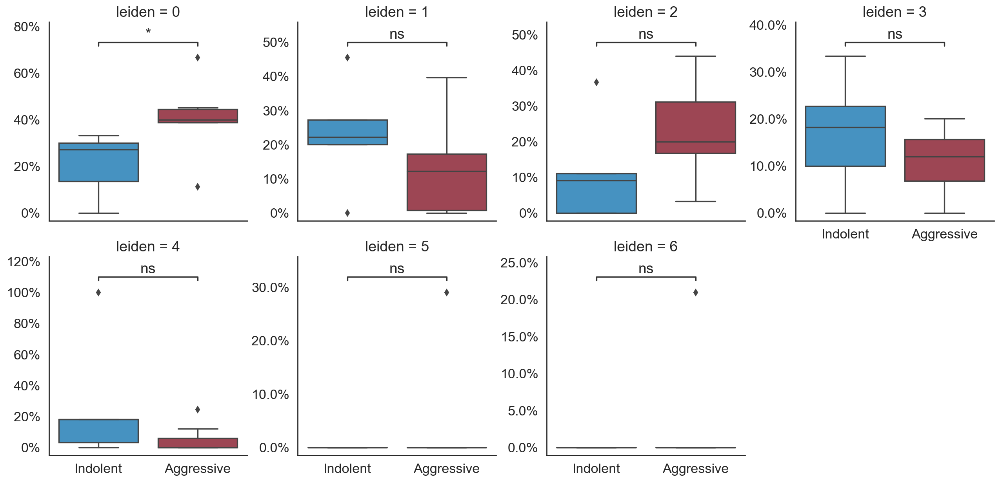

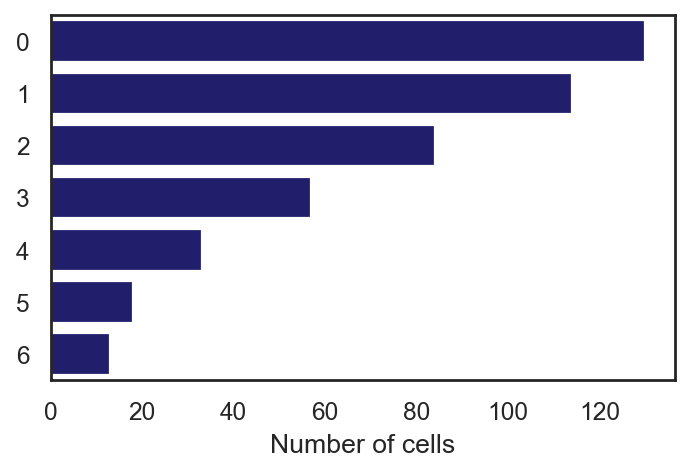

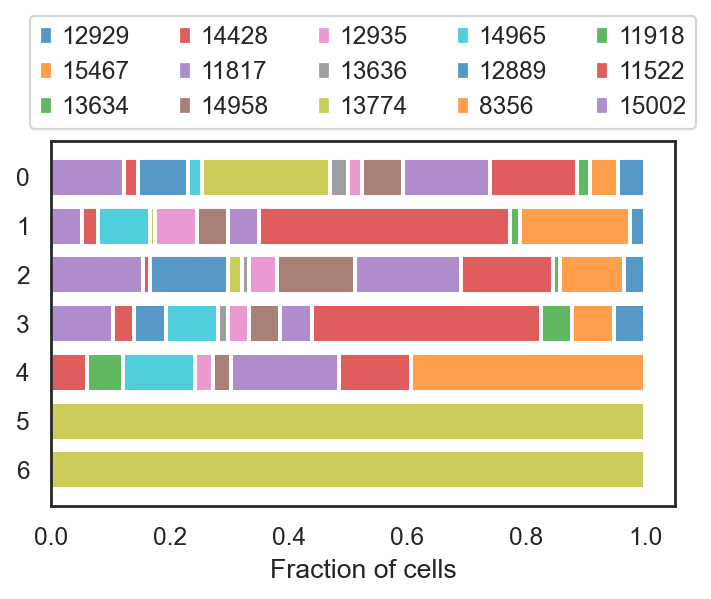

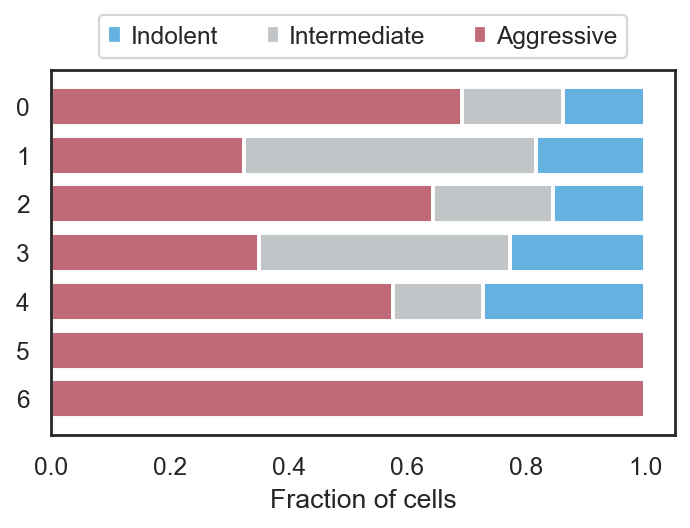

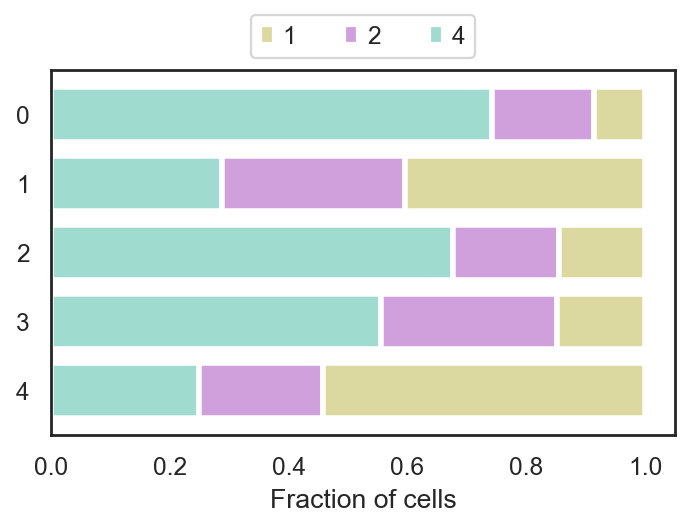

In [21]:
df_dict_group = {}
for idx, ct in enumerate(adata.obs["annotated_ct_higher"].unique()):

    results_file = (
        "../../data/TMA36_project/sc_RNAseq/processed/analyzed/"
        + ct.replace(" ", "_")
        + ".h5ad"
    )

    adata_ct = adata[adata.obs["annotated_ct_higher"] == ct]

    # compute neighbors graph
    sc.pp.neighbors(adata_ct, use_rep="X_harmony")
    sc.tl.umap(adata_ct, random_state=101)

    # run leiden clustering
    sc.tl.leiden(adata_ct, random_state=101, resolution=0.5)
    # len(adata_ct.obs["leiden"].unique())
    # plot umap

    n_cells = adata_ct.obs.shape[0]
    n_clusters = len(adata_ct.obs.leiden.unique())
    sc.pl.umap(
        adata_ct,
        color=["leiden"],
        title=str(n_cells) + " " + ct + ", " + str(n_clusters) + " clusters",
        edges_color="black",
        legend_loc="on data",
        legend_fontsize=12,
        legend_fontoutline=2,
        palette="tab20",
        add_outline=True,
    )

    # density plot by group
    adata_ct.obs["cluster"] = adata_ct.obs["cluster"].astype(str)
    sc.tl.embedding_density(adata_ct, basis="umap", groupby="Group")
    sc.pl.embedding_density(
        adata_ct,
        basis="umap",
        groupby="Group",
        bg_dotsize=80,
        fg_dotsize=40,
        color_map="magma",
    )

    # density plot by DI cluster
    sc.tl.embedding_density(adata_ct, basis="umap", groupby="cluster")
    sc.pl.embedding_density(
        adata_ct,
        basis="umap",
        groupby="cluster",
        bg_dotsize=80,
        fg_dotsize=40,
        color_map="magma",
    )

    # clusters genes ranking
    sc.tl.rank_genes_groups(adata_ct, "leiden", method="wilcoxon")
    # sc.pl.rank_genes_groups(adata_ct, n_genes=25, sharey=False)
    with rc_context({"figure.figsize": (12, 1.5)}):
        sc.pl.rank_genes_groups_violin(adata_ct, n_genes=30, jitter=False)

    # Compare relative abundances
    ## Obtain df with proportions for cell clusters
    count_mat_k = pd.crosstab(adata_ct.obs["sample"], adata_ct.obs["leiden"])
    perc_mat_k = count_mat_k.div(count_mat_k.sum(axis=1), axis=0)
    perc_mat_k.index = perc_mat_k.index.astype(str)
    perc_mat_k = cde[["Group", "cluster", "SILA_score"]].join(perc_mat_k)
    perc_mat_k.reset_index(level=0, inplace=True, col_fill="pt_ID")
    perc_mat_k_long = pd.melt(
        perc_mat_k,
        id_vars=["pt_ID", "Group", "cluster", "SILA_score"],
        var_name="leiden",
        value_name="proportion",
    )
    ## Plot proportions
    plot_proppersample(perc_mat_k_long)

    # write results
    adata_ct.write(results_file)
    n, s, g, di = wrapper_plots(adata_ct, groupby="leiden")
    dict_tables = {
        "number_cells": n,
        "sample_leiden_fraq_long": s,
        "group_leiden_fraq_long": g,
        "dicluster_leiden_fraq_long": di,
    }
    df_dict_group[ct] = dict_tables

## UMAP per cell type clusters

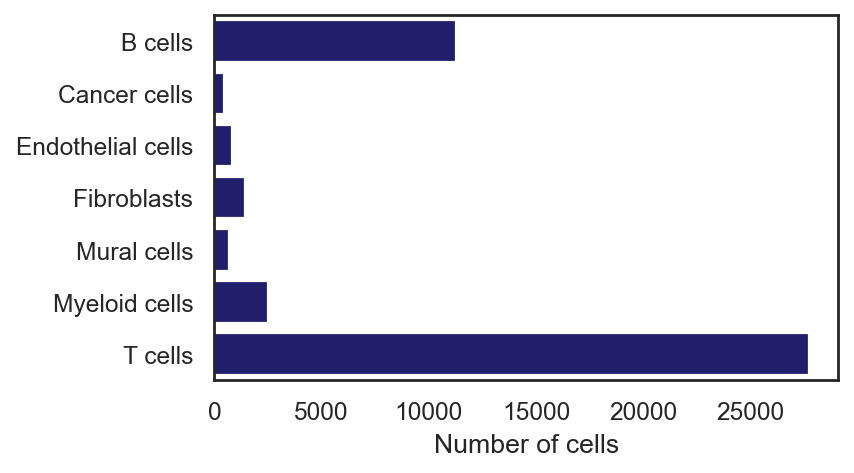

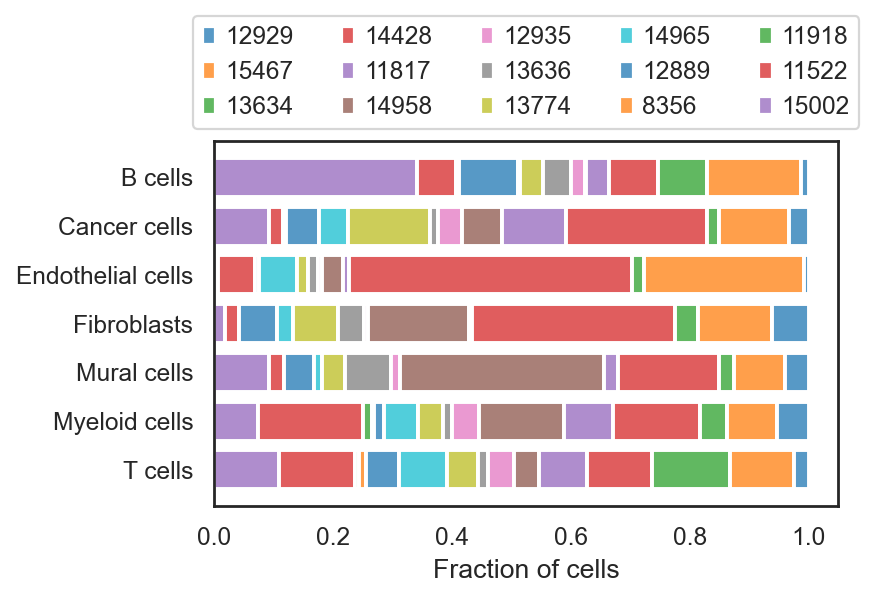

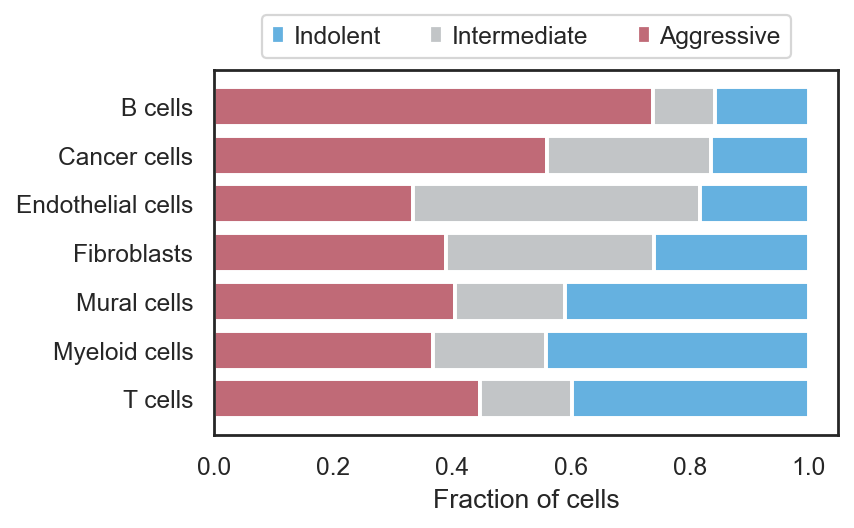

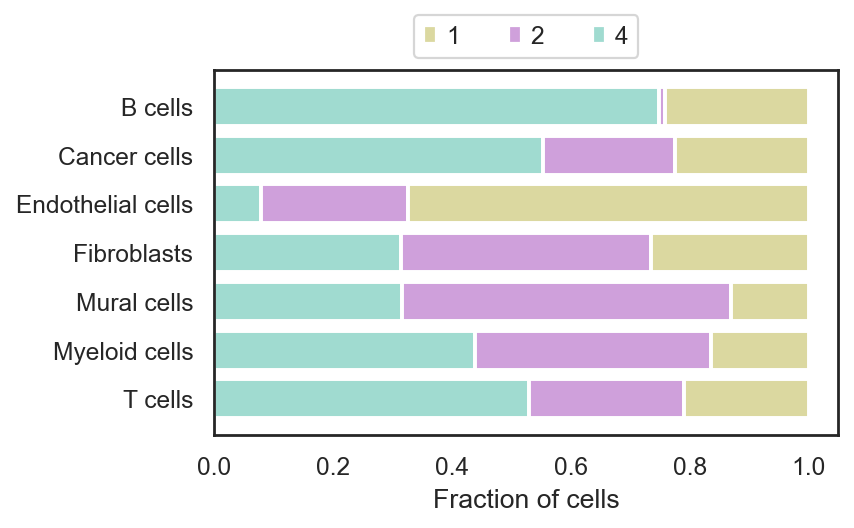

In [22]:
x = wrapper_plots(adata, groupby="annotated_ct_higher")

### T cells

In [23]:
results_file = "../../data/TMA36_project/sc_RNAseq/processed/analyzed/T_cells.h5ad"
adata_ct = sc.read(results_file)

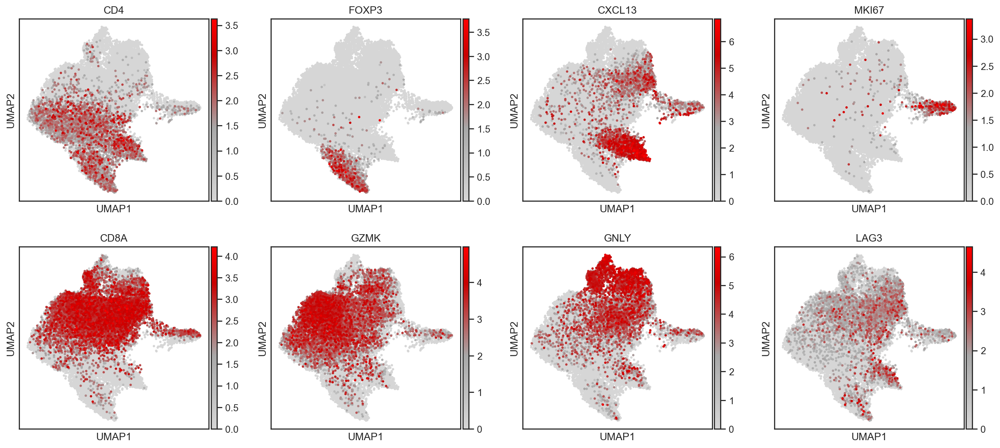

In [24]:
sc.pl.umap(
    adata_ct,
    color_map=umap_cm,
    size=30,
    color=[
        "CD4",
        "FOXP3",
        "CXCL13",
        "MKI67",
        "CD8A",
        "GZMK",
        "GNLY",
        "LAG3",
        # "GZMA",
        # "GZMB",
        # "CTLA4",
        # "PDCD1",
    ],
)

### Myeloid cells

In [25]:
results_file = (
    "../../data/TMA36_project/sc_RNAseq/processed/analyzed/Myeloid_cells.h5ad"
)
adata_ct = sc.read(results_file)

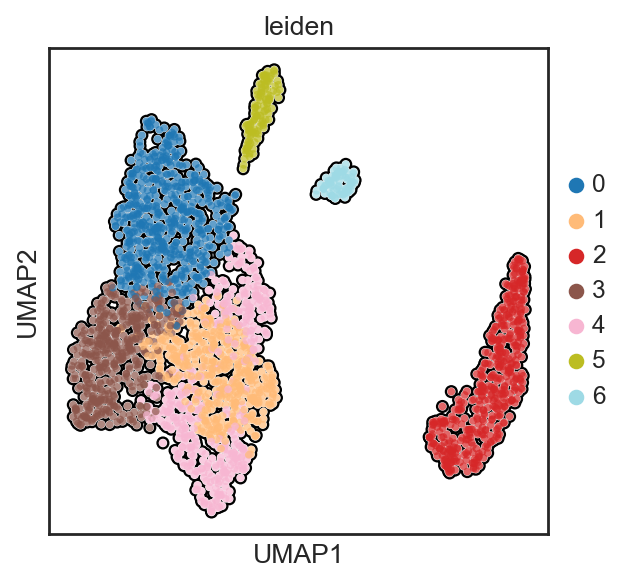

In [26]:
sc.pl.umap(
    adata_ct,
    color=["leiden"],
    edges_color="black",
    add_outline=True,
)

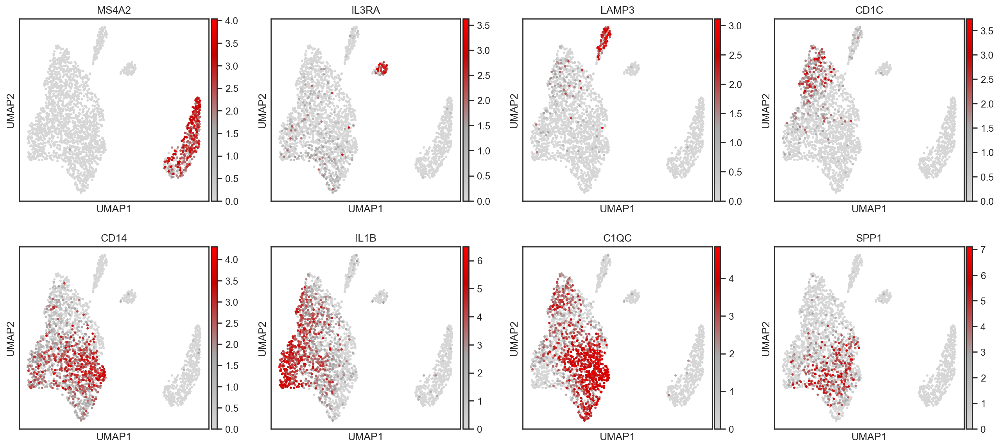

In [27]:
# cDC CLASSICAL https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3853342/ ??
sc.pl.umap(
    adata_ct,
    color_map=umap_cm,
    size=30,
    color=[
        "MS4A2",  # MAST
        "IL3RA",  # pDC,
        "LAMP3",  # DC LAMP
        "CD1C",  # DC CD1C
        "CD14",  # Macrophages
        "IL1B",  # TAMs proinflamatory
        "C1QC",  # TAMs C1QC
        "SPP1",  # Macrophages SPP1
    ],
)

### B cells

In [28]:
results_file = "../../data/TMA36_project/sc_RNAseq/processed/analyzed/B_cells.h5ad"
adata_ct = sc.read(results_file)

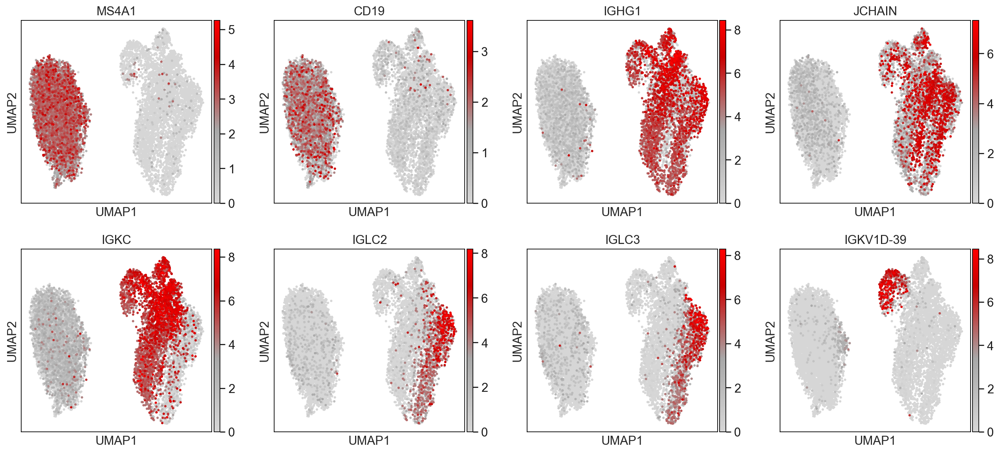

In [29]:
sc.set_figure_params()
sc.pl.umap(
    adata_ct,
    color_map=umap_cm,
    color=["MS4A1", "CD19", "IGHG1", "JCHAIN", "IGKC", "IGLC2", "IGLC3", "IGKV1D-39"],
    size=30,
)

# Compare cell types and clusters

In [30]:
# Define function to obtain a df with statistical test results
def wilcoxon_long(df, group_name, groupA, groupB, var_name, val_name):
    """
    Returns a DataFrame with the results of wilcoxon statistical test

    Parameters:
        df: DataFrame in long format
        group_name: column name of groups to compare
        groupA: str with name of group A
        groupB: str with name of group B
        var_name: column name of the variable to iterate
        val_name: column name of the value

    Returns:
        res_df: DataFrame with results

    """
    # Number of unique elements
    unique_elements = df[var_name].unique()
    n_elem = len(unique_elements)
    res_arr = [[] for x in range(n_elem)]
    for idx, elem in enumerate(unique_elements):
        wilc, pval = stats.ranksums(
            df[(df[group_name] == groupA) & (df[var_name] == elem)][val_name],
            df[(df[group_name] == groupB) & (df[var_name] == elem)][val_name],
        )
        # Saving result to array
        res_arr[idx] = [elem, wilc, pval]
    #
    # Converting array to DataFrame
    res_df = pd.DataFrame(res_arr, columns=[var_name, "wilcoxon", "pvalue"])

    return res_df

In [31]:
# Obtain df with proportions for cell types
count_mat_CT = pd.crosstab(adata.obs["sample"], adata.obs["annotated_ct"])
perc_mat_CT = count_mat_CT.div(count_mat_CT.sum(axis=1), axis=0)
perc_mat_CT.index = perc_mat_CT.index.astype(str)
perc_mat_CT = cde[["Group", "cluster", "SILA_score"]].join(perc_mat_CT)
perc_mat_CT.reset_index(level=0, inplace=True, col_fill="pt_ID")
perc_mat_CT_long = pd.melt(
    perc_mat_CT,
    id_vars=["pt_ID", "Group", "cluster", "SILA_score"],
    var_name="cell_type",
    value_name="proportion",
)

In [32]:
# Obtain df with proportions for cell clusters
count_mat_k = pd.crosstab(adata.obs["sample"], adata.obs["leiden"])
perc_mat_k = count_mat_k.div(count_mat_k.sum(axis=1), axis=0)
perc_mat_k.index = perc_mat_k.index.astype(str)
perc_mat_k = cde[["Group", "cluster", "SILA_score"]].join(perc_mat_k)
perc_mat_k.reset_index(level=0, inplace=True, col_fill="pt_ID")
perc_mat_k_long = pd.melt(
    perc_mat_k,
    id_vars=["pt_ID", "Group", "cluster", "SILA_score"],
    var_name="leiden",
    value_name="proportion",
)

In [33]:
# PCA
features = perc_mat_k.columns[4 : len(perc_mat_k.columns)]
# Separating out the features
x = perc_mat_k.loc[:, features].values
# Standardizing the features
x = StandardScaler().fit_transform(x)

In [34]:
pca = PCA(n_components=3)
principalComponents = pca.fit_transform(x)
principalDf = pd.DataFrame(
    data=principalComponents,
    columns=[
        "PC1",
        "PC2",
        "PC3",
    ],
)
total_var = pca.explained_variance_ratio_.sum() * 100

In [35]:
finalDf = pd.concat(
    [principalDf, perc_mat_k[["pt_ID", "Group", "cluster", "SILA_score"]]], axis=1
)

## Indolent vs aggressive

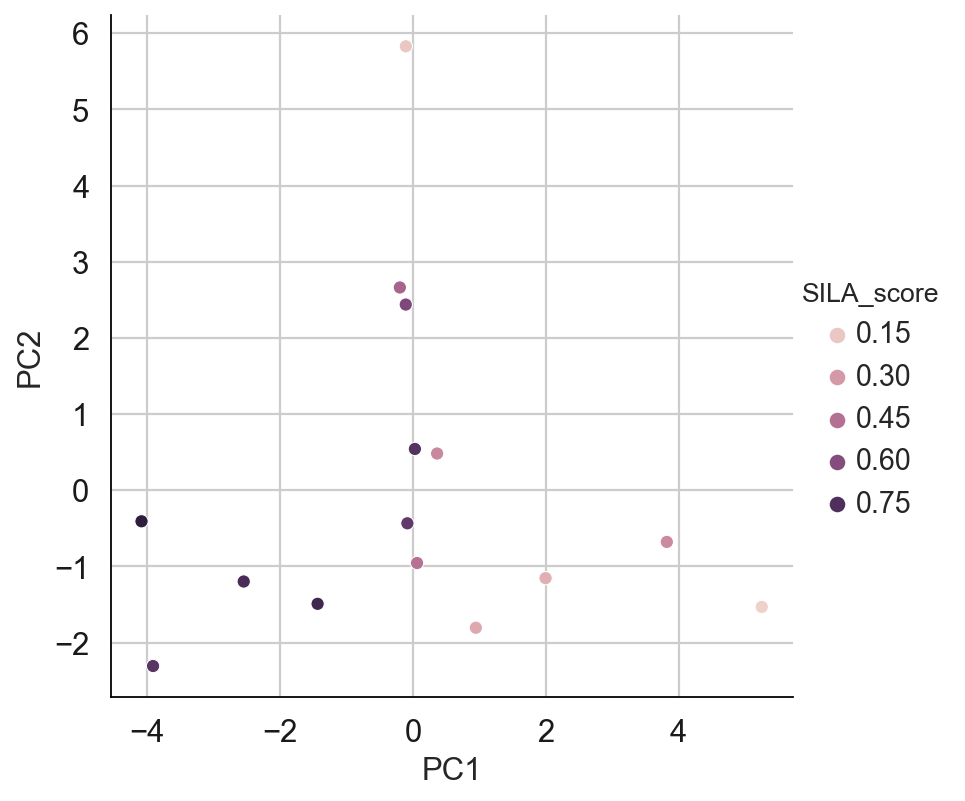

In [36]:
sns.relplot(
    data=finalDf,
    x="PC1",
    y="PC2",
    hue="SILA_score",
    # size="mass",
    # palette=cmap, sizes=(10, 200),
)

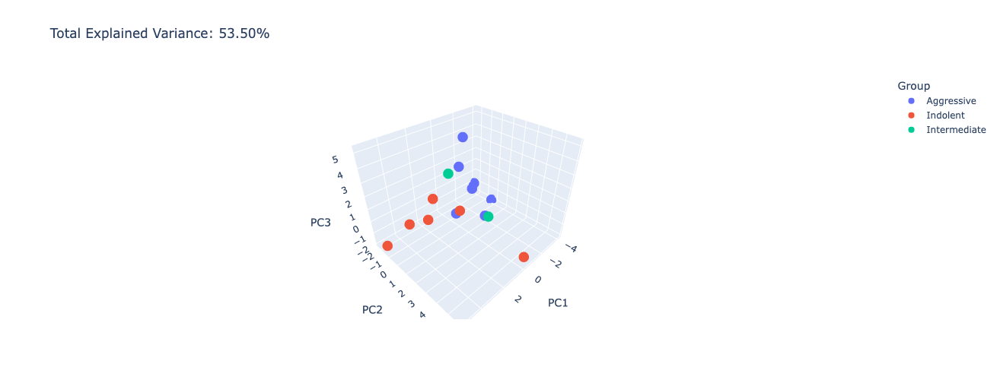

In [37]:
import plotly.express as px

fig = px.scatter_3d(
    finalDf,
    x="PC1",
    y="PC2",
    z="PC3",
    color="Group",
    title=f"Total Explained Variance: {total_var:.2f}%",
    width=500,
    height=500
    # labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'}
)
fig.show()

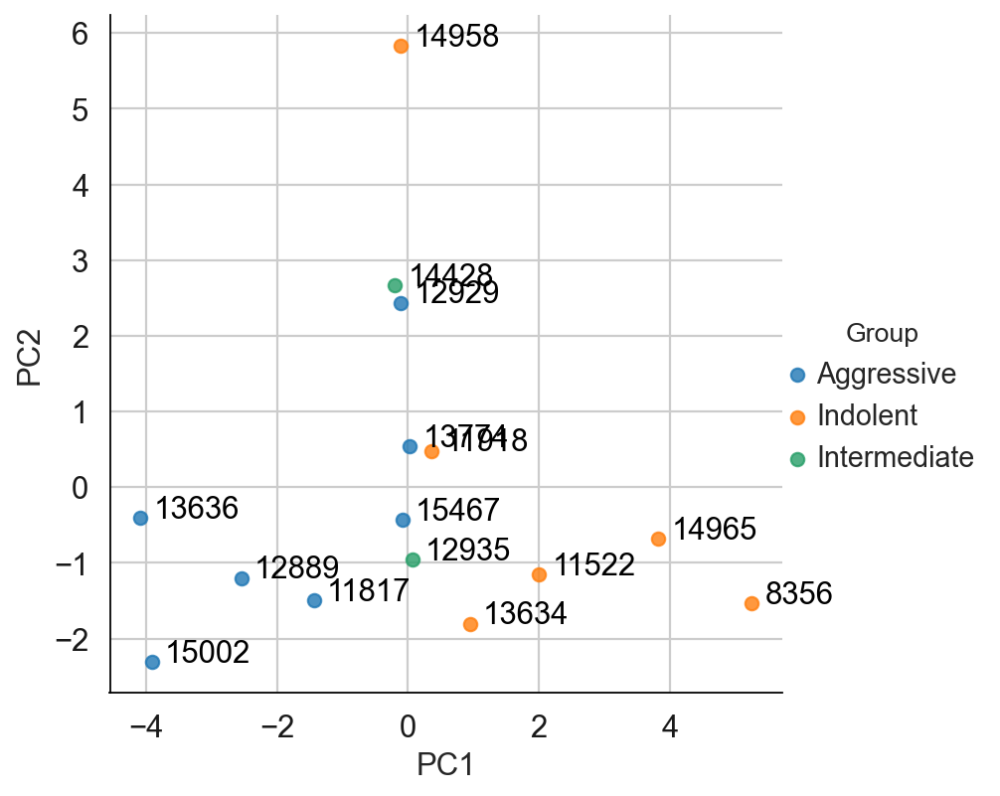

In [38]:
fgrid = sns.lmplot(x="PC1", y="PC2", data=finalDf, hue="Group", fit_reg=False)
ax = fgrid.axes[0, 0]
for line in range(0, finalDf.shape[0]):
    plt.text(
        finalDf.PC1[line] + 0.2,
        finalDf.PC2[line],
        finalDf.pt_ID[line],
        horizontalalignment="left",
        size="medium",
        color="black",
        # weight="semibold",
    )

In [39]:
# By Cell types
res = wilcoxon_long(
    perc_mat_CT_long,
    group_name="Group",
    groupA="Indolent",
    groupB="Aggressive",
    var_name="cell_type",
    val_name="proportion",
)
res[res["pvalue"] < 0.05]

,cell_type,wilcoxon,pvalue
1,CD4+ T cells,2.714286,0.006642
7,Mural cells,-2.000000,0.045500
10,Plasma B cells,-2.857143,0.004275


In [40]:
perc_mat_CT_long

,pt_ID,Group,cluster,SILA_score,cell_type,proportion
0,12929,Aggressive,4,0.622,B cells,0.060854
1,15467,Aggressive,1,0.699,B cells,0.158776
2,13634,Indolent,0,0.250,B cells,0.134765
3,14428,Intermediate,0,0.493,B cells,0.135314
4,11817,Aggressive,4,0.797,B cells,0.106447
...,...,...,...,...,...,...
205,12889,Aggressive,4,0.768,T reg. cells,0.075261
206,8356,Indolent,2,0.115,T reg. cells,0.012232
207,11918,Indolent,0,0.360,T reg. cells,0.026936
208,11522,Indolent,0,0.230,T reg. cells,0.037880


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Indolent vs. Aggressive: Mann-Whitney-Wilcoxon test two-sided, P_val:2.840e-01 U_stat=1.300e+01
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Indolent vs. Aggressive: Mann-Whitney-Wilcoxon test two-sided, P_val:8.221e-03 U_stat=4.000e+01
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Indolent vs. Aggressive: Mann-Whitney-Wilcoxon test two-sided, P_val:4.320e-01 U_stat=2.700e+01
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <

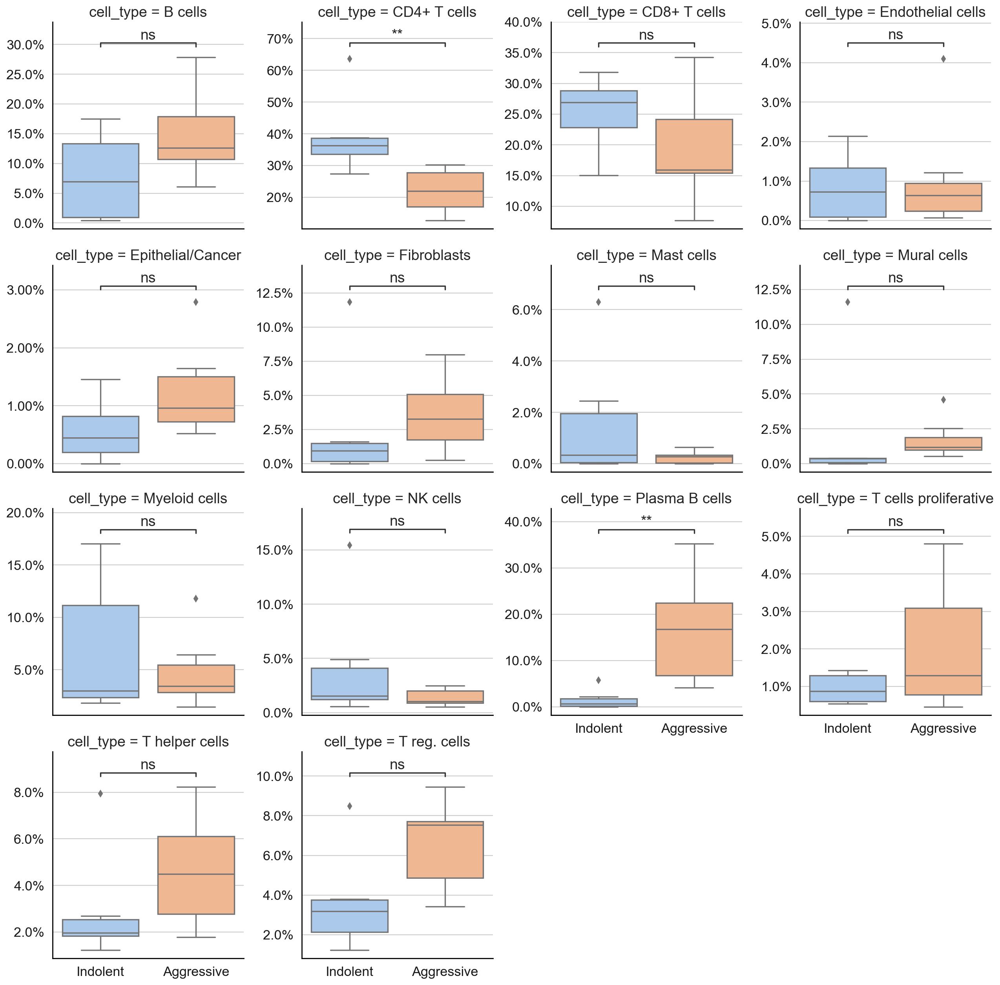

In [41]:
plotting_parameters = {
    "x": "Group",
    "y": "proportion",
    "order": ["Indolent", "Aggressive"],
    "palette": "pastel",
}

pairs = [("Indolent", "Aggressive")]

with sns.plotting_context("notebook", font_scale=1.4):
    annot = Annotator(None, pairs)

    g = sns.FacetGrid(
        perc_mat_CT_long, col="cell_type", col_wrap=4, sharey=False, height=4
    )

    g.map_dataframe(
        annot.plot_and_annotate_facets,
        plot="boxplot",
        plot_params=plotting_parameters,
        configuration={"test": "Mann-Whitney"},
        annotation_func="apply_test",
    )
    for ax in g.axes.flat:
        ax.yaxis.set_major_formatter(PercentFormatter(1))

    plt.show()

In [42]:
# By Cell clusters
res = wilcoxon_long(
    perc_mat_k_long,
    group_name="Group",
    groupA="Indolent",
    groupB="Aggressive",
    var_name="leiden",
    val_name="proportion",
)
res[res["pvalue"] < 0.05]

,leiden,wilcoxon,pvalue
0,0,2.142857,0.032125
3,3,-2.857143,0.004275
17,17,-2.000000,0.045500
20,20,-2.571429,0.010128


In [43]:
perc_mat_k_long

,pt_ID,Group,cluster,SILA_score,leiden,proportion
0,12929,Aggressive,4,0.622,0,0.195277
1,15467,Aggressive,1,0.699,0,0.214130
2,13634,Indolent,0,0.250,0,0.225732
3,14428,Intermediate,0,0.493,0,0.131830
4,11817,Aggressive,4,0.797,0,0.109805
...,...,...,...,...,...,...
370,12889,Aggressive,4,0.768,24,0.000000
371,8356,Indolent,2,0.115,24,0.000000
372,11918,Indolent,0,0.360,24,0.000000
373,11522,Indolent,0,0.230,24,0.000000


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Indolent vs. Aggressive: Mann-Whitney-Wilcoxon test two-sided, P_val:3.832e-02 U_stat=3.600e+01
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Indolent vs. Aggressive: Mann-Whitney-Wilcoxon test two-sided, P_val:2.840e-01 U_stat=1.300e+01
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Indolent vs. Aggressive: Mann-Whitney-Wilcoxon test two-sided, P_val:3.531e-01 U_stat=2.800e+01
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <

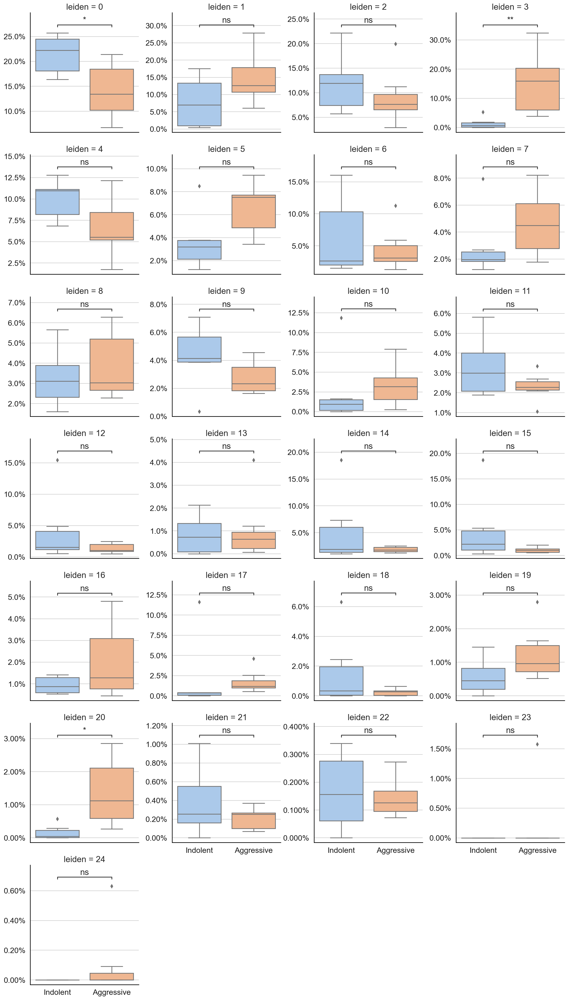

In [44]:
plotting_parameters = {
    "x": "Group",
    "y": "proportion",
    "order": ["Indolent", "Aggressive"],
    "palette": "pastel",
}

pairs = [("Indolent", "Aggressive")]

with sns.plotting_context("notebook", font_scale=1.4):
    annot = Annotator(None, pairs)

    g = sns.FacetGrid(perc_mat_k_long, col="leiden", col_wrap=4, sharey=False, height=4)

    g.map_dataframe(
        annot.plot_and_annotate_facets,
        plot="boxplot",
        plot_params=plotting_parameters,
        configuration={"test": "Mann-Whitney"},
        annotation_func="apply_test",
    )
    for ax in g.axes.flat:
        ax.yaxis.set_major_formatter(PercentFormatter(1))

    plt.show()

## DI clusters 2 vs 4

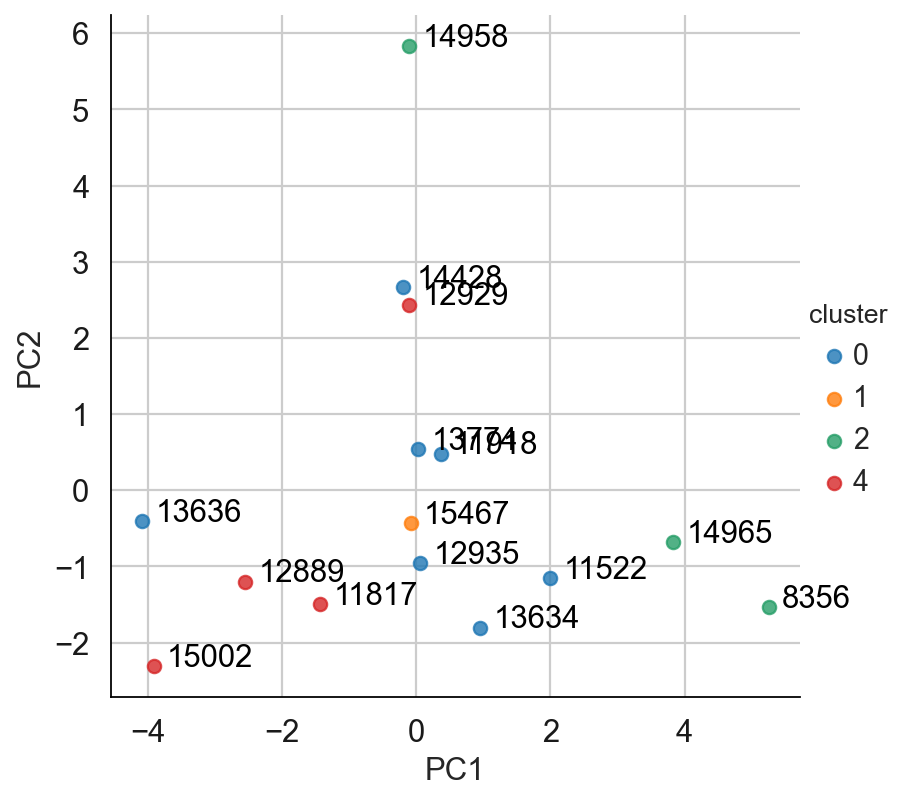

In [45]:
fgrid = sns.lmplot(x="PC1", y="PC2", data=finalDf, hue="cluster", fit_reg=False)
ax = fgrid.axes[0, 0]
for line in range(0, finalDf.shape[0]):
    plt.text(
        finalDf.PC1[line] + 0.2,
        finalDf.PC2[line],
        finalDf.pt_ID[line],
        horizontalalignment="left",
        size="medium",
        color="black",
        # weight="semibold",
    )

In [46]:
# By Cell types
res = wilcoxon_long(
    perc_mat_CT_long,
    group_name="cluster",
    groupA=2,
    groupB=4,
    var_name="cell_type",
    val_name="proportion",
)
res[res["pvalue"] < 0.05]

,cell_type,wilcoxon,pvalue
0,B cells,-2.12132,0.033895
10,Plasma B cells,-2.12132,0.033895
12,T helper cells,-2.12132,0.033895


In [47]:
# By Cell cluster
res = wilcoxon_long(
    perc_mat_k_long,
    group_name="cluster",
    groupA=2,
    groupB=4,
    var_name="leiden",
    val_name="proportion",
)
res[res["pvalue"] < 0.05]

,leiden,wilcoxon,pvalue
1,1,-2.12132,0.033895
3,3,-2.12132,0.033895
7,7,-2.12132,0.033895
20,20,-2.12132,0.033895


## Indolent-like vs Aggressive-like

In [48]:
new_class = [
    "Intermediate_like",
    "Intermediate_like",
    "Indolent_like",
    "Intermediate_like",
    "Aggressive_like",
    "Intermediate_like",
    "Intermediate_like",
    "Aggressive_like",
    "Intermediate_like",
    "Indolent_like",
    "Aggressive_like",
    "Indolent_like",
    "Intermediate_like",
    "Indolent_like",
    "Aggressive_like",
]
perc_mat_k_after = perc_mat_k

perc_mat_k_after["new_class"] = new_class
perc_mat_k_long_after = pd.melt(
    perc_mat_k_after,
    id_vars=["pt_ID", "Group", "cluster", "SILA_score", "new_class"],
    var_name="leiden",
    value_name="proportion",
)
perc_mat_CT_after = perc_mat_CT
perc_mat_CT_after["new_class"] = new_class
perc_mat_CT_long_after = pd.melt(
    perc_mat_CT_after,
    id_vars=["pt_ID", "Group", "cluster", "SILA_score", "new_class"],
    var_name="cell_type",
    value_name="proportion",
)

In [49]:
# By Cell types
res = wilcoxon_long(
    perc_mat_CT_long_after,
    group_name="new_class",
    groupA="Indolent_like",
    groupB="Aggressive_like",
    var_name="cell_type",
    val_name="proportion",
)
res[res["pvalue"] < 0.05]

,cell_type,wilcoxon,pvalue
1,CD4+ T cells,2.309401,0.020921
7,Mural cells,-2.309401,0.020921
10,Plasma B cells,-2.020726,0.043308
11,T cells proliferative,-2.020726,0.043308
13,T reg. cells,-2.309401,0.020921


In [50]:
# By Cell cluster
res = wilcoxon_long(
    perc_mat_k_long_after,
    group_name="new_class",
    groupA="Indolent_like",
    groupB="Aggressive_like",
    var_name="leiden",
    val_name="proportion",
)
res[res["pvalue"] < 0.05]

,leiden,wilcoxon,pvalue
0,0,2.309401,0.020921
3,3,-2.020726,0.043308
4,4,2.020726,0.043308
5,5,-2.309401,0.020921
11,11,2.020726,0.043308
15,15,2.309401,0.020921
16,16,-2.020726,0.043308
17,17,-2.309401,0.020921


In [51]:
finalDf_after = finalDf
finalDf_after["new_class"] = new_class

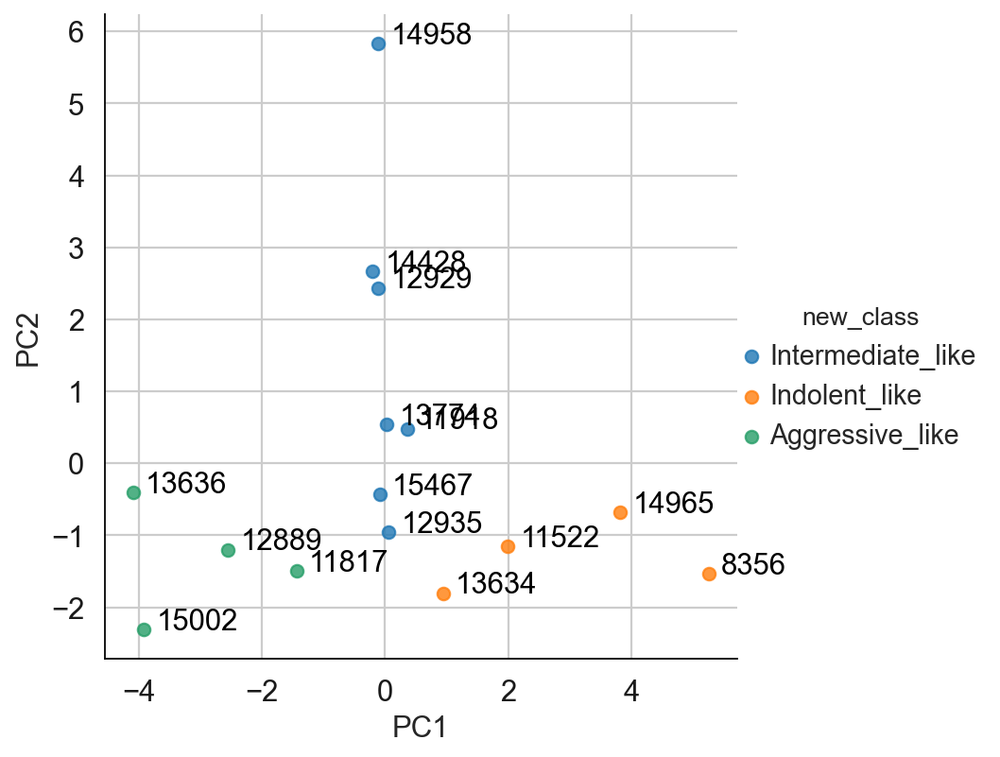

In [52]:
fgrid = sns.lmplot(x="PC1", y="PC2", data=finalDf, hue="new_class", fit_reg=False)
ax = fgrid.axes[0, 0]
for line in range(0, finalDf.shape[0]):
    plt.text(
        finalDf.PC1[line] + 0.2,
        finalDf.PC2[line],
        finalDf.pt_ID[line],
        horizontalalignment="left",
        size="medium",
        color="black",
        # weight="semibold",
    )

# Reclustering of celltypes